In [1]:
import plotly as py
import plotly.graph_objects as go
import plotly.offline as pyo
import plotly.express as px
import pandas as pd 

In [3]:
df = pd.read_csv('data/country_vaccinations.csv')
df

,country,iso_code,date,total_vaccinations,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,vaccines,source_name,source_website
0,Afghanistan,AFG,2021-02-22,0.0,0.0,NaN,NaN,NaN,0.00,0.00,NaN,NaN,"Johnson&Johnson, Oxford/AstraZeneca, Pfizer/Bi...",World Health Organization,https://reliefweb.int/sites/reliefweb.int/file...
1,Afghanistan,AFG,2021-02-23,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,34.0,"Johnson&Johnson, Oxford/AstraZeneca, Pfizer/Bi...",World Health Organization,https://reliefweb.int/sites/reliefweb.int/file...
2,Afghanistan,AFG,2021-02-24,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,34.0,"Johnson&Johnson, Oxford/AstraZeneca, Pfizer/Bi...",World Health Organization,https://reliefweb.int/sites/reliefweb.int/file...
3,Afghanistan,AFG,2021-02-25,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,34.0,"Johnson&Johnson, Oxford/AstraZeneca, Pfizer/Bi...",World Health Organization,https://reliefweb.int/sites/reliefweb.int/file...
4,Afghanistan,AFG,2021-02-26,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,34.0,"Johnson&Johnson, Oxford/AstraZeneca, Pfizer/Bi...",World Health Organization,https://reliefweb.int/sites/reliefweb.int/file...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
62358,Zimbabwe,ZWE,2021-12-01,6640440.0,3809900.0,2830540.0,28498.0,21938.0,44.00,25.24,18.76,1454.0,"Oxford/AstraZeneca, Sinopharm/Beijing, Sinovac...",Ministry of Health,https://www.arcgis.com/home/webmap/viewer.html...
62359,Zimbabwe,ZWE,2021-12-02,6682111.0,3830488.0,2851623.0,41671.0,24152.0,44.28,25.38,18.89,1600.0,"Oxford/AstraZeneca, Sinopharm/Beijing, Sinovac...",Ministry of Health,https://www.arcgis.com/home/webmap/viewer.html...
62360,Zimbabwe,ZWE,2021-12-03,6710095.0,3845246.0,2864849.0,27984.0,23681.0,44.46,25.48,18.98,1569.0,"Oxford/AstraZeneca, Sinopharm/Beijing, Sinovac...",Ministry of Health,https://www.arcgis.com/home/webmap/viewer.html...
62361,Zimbabwe,ZWE,2021-12-04,6742193.0,3866139.0,2876054.0,32098.0,25964.0,44.67,25.62,19.06,1720.0,"Oxford/AstraZeneca, Sinopharm/Beijing, Sinovac...",Ministry of Health,https://www.arcgis.com/home/webmap/viewer.html...


In [4]:
df = df[['country', 'date', 'daily_vaccinations']]
df

,country,date,daily_vaccinations
0,Afghanistan,2021-02-22,NaN
1,Afghanistan,2021-02-23,1367.0
2,Afghanistan,2021-02-24,1367.0
3,Afghanistan,2021-02-25,1367.0
4,Afghanistan,2021-02-26,1367.0
...,...,...,...
62358,Zimbabwe,2021-12-01,21938.0
62359,Zimbabwe,2021-12-02,24152.0
62360,Zimbabwe,2021-12-03,23681.0
62361,Zimbabwe,2021-12-04,25964.0


In [5]:
df=df[df['daily_vaccinations'].notna()]
df.shape

(62031, 3)

In [6]:
#create a list of the unique countries in the dataframe
countries = df['country'].unique().tolist()
countries

['Afghanistan',
 'Albania',
 'Algeria',
 'Andorra',
 'Angola',
 'Anguilla',
 'Antigua and Barbuda',
 'Argentina',
 'Armenia',
 'Aruba',
 'Australia',
 'Austria',
 'Azerbaijan',
 'Bahamas',
 'Bahrain',
 'Bangladesh',
 'Barbados',
 'Belarus',
 'Belgium',
 'Belize',
 'Benin',
 'Bermuda',
 'Bhutan',
 'Bolivia',
 'Bonaire Sint Eustatius and Saba',
 'Bosnia and Herzegovina',
 'Botswana',
 'Brazil',
 'British Virgin Islands',
 'Brunei',
 'Bulgaria',
 'Burkina Faso',
 'Burundi',
 'Cambodia',
 'Cameroon',
 'Canada',
 'Cape Verde',
 'Cayman Islands',
 'Central African Republic',
 'Chad',
 'Chile',
 'China',
 'Colombia',
 'Comoros',
 'Congo',
 'Cook Islands',
 'Costa Rica',
 "Cote d'Ivoire",
 'Croatia',
 'Cuba',
 'Curacao',
 'Cyprus',
 'Czechia',
 'Democratic Republic of Congo',
 'Denmark',
 'Djibouti',
 'Dominica',
 'Dominican Republic',
 'Ecuador',
 'Egypt',
 'El Salvador',
 'England',
 'Equatorial Guinea',
 'Estonia',
 'Eswatini',
 'Ethiopia',
 'Faeroe Islands',
 'Falkland Islands',
 'Fiji',
 

In [7]:
#creating a dictionary of data frames for each unique country 
df_dict = {country:df.loc[df['country'] == country] for country in countries}

In [8]:
df_dict

{'Afghanistan':          country        date  daily_vaccinations
 1    Afghanistan  2021-02-23              1367.0
 2    Afghanistan  2021-02-24              1367.0
 3    Afghanistan  2021-02-25              1367.0
 4    Afghanistan  2021-02-26              1367.0
 5    Afghanistan  2021-02-27              1367.0
 ..           ...         ...                 ...
 274  Afghanistan  2021-11-23            111479.0
 275  Afghanistan  2021-11-24             87607.0
 276  Afghanistan  2021-11-25             63735.0
 277  Afghanistan  2021-11-26             39863.0
 278  Afghanistan  2021-11-27             15991.0
 
 [278 rows x 3 columns],
 'Albania':      country        date  daily_vaccinations
 280  Albania  2021-01-11                64.0
 281  Albania  2021-01-12                64.0
 282  Albania  2021-01-13                63.0
 283  Albania  2021-01-14                66.0
 284  Albania  2021-01-15                62.0
 ..       ...         ...                 ...
 604  Albania  2021-12-01

In [9]:
df_dict['United States']

,country,date,daily_vaccinations
59404,United States,2020-12-14,4356.0
59405,United States,2020-12-15,26710.0
59406,United States,2020-12-16,70879.0
59407,United States,2020-12-17,120907.0
59408,United States,2020-12-18,179437.0
...,...,...,...
59757,United States,2021-12-02,1312078.0
59758,United States,2021-12-03,1398202.0
59759,United States,2021-12-04,1388109.0
59760,United States,2021-12-05,1318753.0


In [ ]:
df_dict['United States'].columns
for key, df in df_dict.items(): 
    for i in df.iterrows(): 
        print(i)

(1, country               Afghanistan
date                   2021-02-23
daily_vaccinations           1367
Name: 1, dtype: object)
(2, country               Afghanistan
date                   2021-02-24
daily_vaccinations           1367
Name: 2, dtype: object)
(3, country               Afghanistan
date                   2021-02-25
daily_vaccinations           1367
Name: 3, dtype: object)
(4, country               Afghanistan
date                   2021-02-26
daily_vaccinations           1367
Name: 4, dtype: object)
(5, country               Afghanistan
date                   2021-02-27
daily_vaccinations           1367
Name: 5, dtype: object)
(6, country               Afghanistan
date                   2021-02-28
daily_vaccinations           1367
Name: 6, dtype: object)
(7, country               Afghanistan
date                   2021-03-01
daily_vaccinations           1580
Name: 7, dtype: object)
(8, country               Afghanistan
date                   2021-03-02
daily_vaccinations

Name: 913, dtype: object)
(914, country                  Algeria
date                  2021-11-30
daily_vaccinations         35110
Name: 914, dtype: object)
(916, country                  Andorra
date                  2021-01-26
daily_vaccinations            66
Name: 916, dtype: object)
(917, country                  Andorra
date                  2021-01-27
daily_vaccinations            66
Name: 917, dtype: object)
(918, country                  Andorra
date                  2021-01-28
daily_vaccinations            66
Name: 918, dtype: object)
(919, country                  Andorra
date                  2021-01-29
daily_vaccinations            66
Name: 919, dtype: object)
(920, country                  Andorra
date                  2021-01-30
daily_vaccinations            66
Name: 920, dtype: object)
(921, country                  Andorra
date                  2021-01-31
daily_vaccinations            66
Name: 921, dtype: object)
(922, country                  Andorra
date              

(1415, country                   Angola
date                  2021-10-07
daily_vaccinations         78378
Name: 1415, dtype: object)
(1416, country                   Angola
date                  2021-10-08
daily_vaccinations         78378
Name: 1416, dtype: object)
(1417, country                   Angola
date                  2021-10-09
daily_vaccinations         76086
Name: 1417, dtype: object)
(1418, country                   Angola
date                  2021-10-10
daily_vaccinations         73793
Name: 1418, dtype: object)
(1419, country                   Angola
date                  2021-10-11
daily_vaccinations         71500
Name: 1419, dtype: object)
(1420, country                   Angola
date                  2021-10-12
daily_vaccinations         69207
Name: 1420, dtype: object)
(1421, country                   Angola
date                  2021-10-13
daily_vaccinations         66915
Name: 1421, dtype: object)
(1422, country                   Angola
date                  2021-10

Name: 1916, dtype: object)
(1917, country               Antigua and Barbuda
date                           2021-07-06
daily_vaccinations                    118
Name: 1917, dtype: object)
(1918, country               Antigua and Barbuda
date                           2021-07-07
daily_vaccinations                    104
Name: 1918, dtype: object)
(1919, country               Antigua and Barbuda
date                           2021-07-08
daily_vaccinations                     89
Name: 1919, dtype: object)
(1920, country               Antigua and Barbuda
date                           2021-07-09
daily_vaccinations                    115
Name: 1920, dtype: object)
(1921, country               Antigua and Barbuda
date                           2021-07-10
daily_vaccinations                    114
Name: 1921, dtype: object)
(1922, country               Antigua and Barbuda
date                           2021-07-11
daily_vaccinations                    114
Name: 1922, dtype: object)
(1923, countr

(2597, country                  Armenia
date                  2021-10-05
daily_vaccinations          7047
Name: 2597, dtype: object)
(2598, country                  Armenia
date                  2021-10-06
daily_vaccinations          7047
Name: 2598, dtype: object)
(2599, country                  Armenia
date                  2021-10-07
daily_vaccinations          7047
Name: 2599, dtype: object)
(2600, country                  Armenia
date                  2021-10-08
daily_vaccinations          7047
Name: 2600, dtype: object)
(2601, country                  Armenia
date                  2021-10-09
daily_vaccinations          7047
Name: 2601, dtype: object)
(2602, country                  Armenia
date                  2021-10-10
daily_vaccinations          7047
Name: 2602, dtype: object)
(2603, country                  Armenia
date                  2021-10-11
daily_vaccinations          7047
Name: 2603, dtype: object)
(2604, country                  Armenia
date                  2021-10

Name: 3420, dtype: object)
(3421, country                  Austria
date                  2021-08-11
daily_vaccinations         33785
Name: 3421, dtype: object)
(3422, country                  Austria
date                  2021-08-12
daily_vaccinations         32398
Name: 3422, dtype: object)
(3423, country                  Austria
date                  2021-08-13
daily_vaccinations         29526
Name: 3423, dtype: object)
(3424, country                  Austria
date                  2021-08-14
daily_vaccinations         27891
Name: 3424, dtype: object)
(3425, country                  Austria
date                  2021-08-15
daily_vaccinations         25607
Name: 3425, dtype: object)
(3426, country                  Austria
date                  2021-08-16
daily_vaccinations         26755
Name: 3426, dtype: object)
(3427, country                  Austria
date                  2021-08-17
daily_vaccinations         24621
Name: 3427, dtype: object)
(3428, country                  Austria
da

(3922, country                  Bahamas
date                  2021-05-12
daily_vaccinations          1000
Name: 3922, dtype: object)
(3923, country                  Bahamas
date                  2021-05-13
daily_vaccinations          1046
Name: 3923, dtype: object)
(3924, country                  Bahamas
date                  2021-05-14
daily_vaccinations          1093
Name: 3924, dtype: object)
(3925, country                  Bahamas
date                  2021-05-15
daily_vaccinations          1140
Name: 3925, dtype: object)
(3926, country                  Bahamas
date                  2021-05-16
daily_vaccinations          1187
Name: 3926, dtype: object)
(3927, country                  Bahamas
date                  2021-05-17
daily_vaccinations          1187
Name: 3927, dtype: object)
(3928, country                  Bahamas
date                  2021-05-18
daily_vaccinations          1187
Name: 3928, dtype: object)
(3929, country                  Bahamas
date                  2021-05

Name: 4422, dtype: object)
(4423, country                  Bahrain
date                  2021-10-18
daily_vaccinations          5945
Name: 4423, dtype: object)
(4424, country                  Bahrain
date                  2021-10-19
daily_vaccinations          5734
Name: 4424, dtype: object)
(4425, country                  Bahrain
date                  2021-10-20
daily_vaccinations          5599
Name: 4425, dtype: object)
(4426, country                  Bahrain
date                  2021-10-21
daily_vaccinations          5456
Name: 4426, dtype: object)
(4427, country                  Bahrain
date                  2021-10-22
daily_vaccinations          5319
Name: 4427, dtype: object)
(4428, country                  Bahrain
date                  2021-10-23
daily_vaccinations          5127
Name: 4428, dtype: object)
(4429, country                  Bahrain
date                  2021-10-24
daily_vaccinations          4768
Name: 4429, dtype: object)
(4430, country                  Bahrain
da

(5426, country                  Belgium
date                  2021-01-06
daily_vaccinations           846
Name: 5426, dtype: object)
(5427, country                  Belgium
date                  2021-01-07
daily_vaccinations          2054
Name: 5427, dtype: object)
(5428, country                  Belgium
date                  2021-01-08
daily_vaccinations          3398
Name: 5428, dtype: object)
(5429, country                  Belgium
date                  2021-01-09
daily_vaccinations          3864
Name: 5429, dtype: object)
(5430, country                  Belgium
date                  2021-01-10
daily_vaccinations          3922
Name: 5430, dtype: object)
(5431, country                  Belgium
date                  2021-01-11
daily_vaccinations          4733
Name: 5431, dtype: object)
(5432, country                  Belgium
date                  2021-01-12
daily_vaccinations          6776
Name: 5432, dtype: object)
(5433, country                  Belgium
date                  2021-01

Name: 6131, dtype: object)
(6132, country                    Benin
date                  2021-08-13
daily_vaccinations           206
Name: 6132, dtype: object)
(6133, country                    Benin
date                  2021-08-14
daily_vaccinations           206
Name: 6133, dtype: object)
(6134, country                    Benin
date                  2021-08-15
daily_vaccinations           206
Name: 6134, dtype: object)
(6135, country                    Benin
date                  2021-08-16
daily_vaccinations           206
Name: 6135, dtype: object)
(6136, country                    Benin
date                  2021-08-17
daily_vaccinations           890
Name: 6136, dtype: object)
(6137, country                    Benin
date                  2021-08-18
daily_vaccinations          1575
Name: 6137, dtype: object)
(6138, country                    Benin
date                  2021-08-19
daily_vaccinations          2260
Name: 6138, dtype: object)
(6139, country                    Benin
da

Name: 6731, dtype: object)
(6732, country                   Bhutan
date                  2021-10-02
daily_vaccinations           526
Name: 6732, dtype: object)
(6733, country                   Bhutan
date                  2021-10-03
daily_vaccinations           312
Name: 6733, dtype: object)
(6734, country                   Bhutan
date                  2021-10-04
daily_vaccinations           359
Name: 6734, dtype: object)
(6735, country                   Bhutan
date                  2021-10-05
daily_vaccinations           406
Name: 6735, dtype: object)
(6736, country                   Bhutan
date                  2021-10-06
daily_vaccinations           453
Name: 6736, dtype: object)
(6737, country                   Bhutan
date                  2021-10-07
daily_vaccinations           500
Name: 6737, dtype: object)
(6738, country                   Bhutan
date                  2021-10-08
daily_vaccinations           547
Name: 6738, dtype: object)
(6739, country                   Bhutan
da

Name: 7239, dtype: object)
(7240, country               Bonaire Sint Eustatius and Saba
date                                       2021-08-29
daily_vaccinations                                196
Name: 7240, dtype: object)
(7241, country               Bonaire Sint Eustatius and Saba
date                                       2021-08-30
daily_vaccinations                                196
Name: 7241, dtype: object)
(7242, country               Bonaire Sint Eustatius and Saba
date                                       2021-08-31
daily_vaccinations                                196
Name: 7242, dtype: object)
(7243, country               Bonaire Sint Eustatius and Saba
date                                       2021-09-01
daily_vaccinations                                196
Name: 7243, dtype: object)
(7245, country               Bosnia and Herzegovina
date                              2021-02-12
daily_vaccinations                       574
Name: 7245, dtype: object)
(7246, country      

Name: 7806, dtype: object)
(7807, country                   Brazil
date                  2021-03-01
daily_vaccinations        220567
Name: 7807, dtype: object)
(7808, country                   Brazil
date                  2021-03-02
daily_vaccinations        246521
Name: 7808, dtype: object)
(7809, country                   Brazil
date                  2021-03-03
daily_vaccinations        277239
Name: 7809, dtype: object)
(7810, country                   Brazil
date                  2021-03-04
daily_vaccinations        295339
Name: 7810, dtype: object)
(7811, country                   Brazil
date                  2021-03-05
daily_vaccinations        322071
Name: 7811, dtype: object)
(7812, country                   Brazil
date                  2021-03-06
daily_vaccinations        342446
Name: 7812, dtype: object)
(7813, country                   Brazil
date                  2021-03-07
daily_vaccinations        354715
Name: 7813, dtype: object)
(7814, country                   Brazil
da

(8426, country                   Brunei
date                  2021-08-21
daily_vaccinations          5591
Name: 8426, dtype: object)
(8427, country                   Brunei
date                  2021-08-22
daily_vaccinations          5804
Name: 8427, dtype: object)
(8428, country                   Brunei
date                  2021-08-23
daily_vaccinations          6017
Name: 8428, dtype: object)
(8429, country                   Brunei
date                  2021-08-24
daily_vaccinations          6564
Name: 8429, dtype: object)
(8430, country                   Brunei
date                  2021-08-25
daily_vaccinations          7089
Name: 8430, dtype: object)
(8431, country                   Brunei
date                  2021-08-26
daily_vaccinations          7036
Name: 8431, dtype: object)
(8432, country                   Brunei
date                  2021-08-27
daily_vaccinations          6982
Name: 8432, dtype: object)
(8433, country                   Brunei
date                  2021-08

(8936, country               Burkina Faso
date                    2021-08-01
daily_vaccinations             159
Name: 8936, dtype: object)
(8937, country               Burkina Faso
date                    2021-08-02
daily_vaccinations             159
Name: 8937, dtype: object)
(8938, country               Burkina Faso
date                    2021-08-03
daily_vaccinations             159
Name: 8938, dtype: object)
(8939, country               Burkina Faso
date                    2021-08-04
daily_vaccinations             159
Name: 8939, dtype: object)
(8940, country               Burkina Faso
date                    2021-08-05
daily_vaccinations             159
Name: 8940, dtype: object)
(8941, country               Burkina Faso
date                    2021-08-06
daily_vaccinations             159
Name: 8941, dtype: object)
(8942, country               Burkina Faso
date                    2021-08-07
daily_vaccinations             159
Name: 8942, dtype: object)
(8943, country             

(9581, country                 Cameroon
date                  2021-11-01
daily_vaccinations           475
Name: 9581, dtype: object)
(9582, country                 Cameroon
date                  2021-11-02
daily_vaccinations           440
Name: 9582, dtype: object)
(9583, country                 Cameroon
date                  2021-11-03
daily_vaccinations           404
Name: 9583, dtype: object)
(9584, country                 Cameroon
date                  2021-11-04
daily_vaccinations           558
Name: 9584, dtype: object)
(9585, country                 Cameroon
date                  2021-11-05
daily_vaccinations           604
Name: 9585, dtype: object)
(9586, country                 Cameroon
date                  2021-11-06
daily_vaccinations           651
Name: 9586, dtype: object)
(9587, country                 Cameroon
date                  2021-11-07
daily_vaccinations           697
Name: 9587, dtype: object)
(9588, country                 Cameroon
date                  2021-11

Name: 10325, dtype: object)
(10326, country               Cayman Islands
date                      2021-03-26
daily_vaccinations               829
Name: 10326, dtype: object)
(10327, country               Cayman Islands
date                      2021-03-27
daily_vaccinations               860
Name: 10327, dtype: object)
(10328, country               Cayman Islands
date                      2021-03-28
daily_vaccinations               890
Name: 10328, dtype: object)
(10329, country               Cayman Islands
date                      2021-03-29
daily_vaccinations               921
Name: 10329, dtype: object)
(10330, country               Cayman Islands
date                      2021-03-30
daily_vaccinations               928
Name: 10330, dtype: object)
(10331, country               Cayman Islands
date                      2021-03-31
daily_vaccinations               934
Name: 10331, dtype: object)
(10332, country               Cayman Islands
date                      2021-04-01
daily_va

(10866, country                     Chad
date                  2021-08-29
daily_vaccinations           879
Name: 10866, dtype: object)
(10867, country                     Chad
date                  2021-08-30
daily_vaccinations          1058
Name: 10867, dtype: object)
(10868, country                     Chad
date                  2021-08-31
daily_vaccinations          1561
Name: 10868, dtype: object)
(10869, country                     Chad
date                  2021-09-01
daily_vaccinations          2064
Name: 10869, dtype: object)
(10870, country                     Chad
date                  2021-09-02
daily_vaccinations          2567
Name: 10870, dtype: object)
(10871, country                     Chad
date                  2021-09-03
daily_vaccinations          2630
Name: 10871, dtype: object)
(10872, country                     Chad
date                  2021-09-04
daily_vaccinations          2693
Name: 10872, dtype: object)
(10873, country                     Chad
date          

Name: 11378, dtype: object)
(11379, country                    China
date                  2021-02-20
daily_vaccinations        631579
Name: 11379, dtype: object)
(11380, country                    China
date                  2021-02-21
daily_vaccinations        631579
Name: 11380, dtype: object)
(11381, country                    China
date                  2021-02-22
daily_vaccinations        631579
Name: 11381, dtype: object)
(11382, country                    China
date                  2021-02-23
daily_vaccinations        631579
Name: 11382, dtype: object)
(11383, country                    China
date                  2021-02-24
daily_vaccinations        631579
Name: 11383, dtype: object)
(11384, country                    China
date                  2021-02-25
daily_vaccinations        631579
Name: 11384, dtype: object)
(11385, country                    China
date                  2021-02-26
daily_vaccinations        631579
Name: 11385, dtype: object)
(11386, country            

(11937, country                 Colombia
date                  2021-11-12
daily_vaccinations        364994
Name: 11937, dtype: object)
(11938, country                 Colombia
date                  2021-11-13
daily_vaccinations        349340
Name: 11938, dtype: object)
(11939, country                 Colombia
date                  2021-11-14
daily_vaccinations        354253
Name: 11939, dtype: object)
(11940, country                 Colombia
date                  2021-11-15
daily_vaccinations        320974
Name: 11940, dtype: object)
(11941, country                 Colombia
date                  2021-11-16
daily_vaccinations        314271
Name: 11941, dtype: object)
(11942, country                 Colombia
date                  2021-11-17
daily_vaccinations        317000
Name: 11942, dtype: object)
(11943, country                 Colombia
date                  2021-11-18
daily_vaccinations        323611
Name: 11943, dtype: object)
(11944, country                 Colombia
date          

Name: 12390, dtype: object)
(12391, country                    Congo
date                  2021-11-10
daily_vaccinations          6727
Name: 12391, dtype: object)
(12392, country                    Congo
date                  2021-11-11
daily_vaccinations          6473
Name: 12392, dtype: object)
(12393, country                    Congo
date                  2021-11-12
daily_vaccinations          6279
Name: 12393, dtype: object)
(12394, country                    Congo
date                  2021-11-13
daily_vaccinations          6085
Name: 12394, dtype: object)
(12395, country                    Congo
date                  2021-11-14
daily_vaccinations          5891
Name: 12395, dtype: object)
(12396, country                    Congo
date                  2021-11-15
daily_vaccinations          5697
Name: 12396, dtype: object)
(12397, country                    Congo
date                  2021-11-16
daily_vaccinations          5503
Name: 12397, dtype: object)
(12398, country            

Name: 12805, dtype: object)
(12806, country               Costa Rica
date                  2021-08-05
daily_vaccinations         15659
Name: 12806, dtype: object)
(12807, country               Costa Rica
date                  2021-08-06
daily_vaccinations         15659
Name: 12807, dtype: object)
(12808, country               Costa Rica
date                  2021-08-07
daily_vaccinations         15659
Name: 12808, dtype: object)
(12809, country               Costa Rica
date                  2021-08-08
daily_vaccinations         15659
Name: 12809, dtype: object)
(12810, country               Costa Rica
date                  2021-08-09
daily_vaccinations         15659
Name: 12810, dtype: object)
(12811, country               Costa Rica
date                  2021-08-10
daily_vaccinations         17599
Name: 12811, dtype: object)
(12812, country               Costa Rica
date                  2021-08-11
daily_vaccinations         19538
Name: 12812, dtype: object)
(12813, country            

(13449, country                  Croatia
date                  2021-09-02
daily_vaccinations          5948
Name: 13449, dtype: object)
(13450, country                  Croatia
date                  2021-09-03
daily_vaccinations          5778
Name: 13450, dtype: object)
(13451, country                  Croatia
date                  2021-09-04
daily_vaccinations          5672
Name: 13451, dtype: object)
(13452, country                  Croatia
date                  2021-09-05
daily_vaccinations          5554
Name: 13452, dtype: object)
(13453, country                  Croatia
date                  2021-09-06
daily_vaccinations          5357
Name: 13453, dtype: object)
(13454, country                  Croatia
date                  2021-09-07
daily_vaccinations          5193
Name: 13454, dtype: object)
(13455, country                  Croatia
date                  2021-09-08
daily_vaccinations          5030
Name: 13455, dtype: object)
(13456, country                  Croatia
date          

Name: 13969, dtype: object)
(13970, country                  Curacao
date                  2021-11-03
daily_vaccinations           170
Name: 13970, dtype: object)
(13971, country                  Curacao
date                  2021-11-04
daily_vaccinations           200
Name: 13971, dtype: object)
(13972, country                  Curacao
date                  2021-11-05
daily_vaccinations           231
Name: 13972, dtype: object)
(13973, country                  Curacao
date                  2021-11-06
daily_vaccinations           180
Name: 13973, dtype: object)
(13974, country                  Curacao
date                  2021-11-07
daily_vaccinations           179
Name: 13974, dtype: object)
(13975, country                  Curacao
date                  2021-11-08
daily_vaccinations           178
Name: 13975, dtype: object)
(13976, country                  Curacao
date                  2021-11-09
daily_vaccinations           177
Name: 13976, dtype: object)
(13977, country            

(14471, country                  Czechia
date                  2021-05-10
daily_vaccinations         66143
Name: 14471, dtype: object)
(14472, country                  Czechia
date                  2021-05-11
daily_vaccinations         67544
Name: 14472, dtype: object)
(14473, country                  Czechia
date                  2021-05-12
daily_vaccinations         68512
Name: 14473, dtype: object)
(14474, country                  Czechia
date                  2021-05-13
daily_vaccinations         68873
Name: 14474, dtype: object)
(14475, country                  Czechia
date                  2021-05-14
daily_vaccinations         68971
Name: 14475, dtype: object)
(14476, country                  Czechia
date                  2021-05-15
daily_vaccinations         69399
Name: 14476, dtype: object)
(14477, country                  Czechia
date                  2021-05-16
daily_vaccinations         69630
Name: 14477, dtype: object)
(14478, country                  Czechia
date          

Name: 15077, dtype: object)
(15078, country                  Denmark
date                  2021-05-18
daily_vaccinations         47681
Name: 15078, dtype: object)
(15079, country                  Denmark
date                  2021-05-19
daily_vaccinations         47843
Name: 15079, dtype: object)
(15080, country                  Denmark
date                  2021-05-20
daily_vaccinations         44576
Name: 15080, dtype: object)
(15081, country                  Denmark
date                  2021-05-21
daily_vaccinations         43247
Name: 15081, dtype: object)
(15082, country                  Denmark
date                  2021-05-22
daily_vaccinations         50905
Name: 15082, dtype: object)
(15083, country                  Denmark
date                  2021-05-23
daily_vaccinations         50133
Name: 15083, dtype: object)
(15084, country                  Denmark
date                  2021-05-24
daily_vaccinations         46217
Name: 15084, dtype: object)
(15085, country            

(15545, country                 Dominica
date                  2021-03-18
daily_vaccinations           158
Name: 15545, dtype: object)
(15546, country                 Dominica
date                  2021-03-19
daily_vaccinations           158
Name: 15546, dtype: object)
(15547, country                 Dominica
date                  2021-03-20
daily_vaccinations           158
Name: 15547, dtype: object)
(15548, country                 Dominica
date                  2021-03-21
daily_vaccinations           158
Name: 15548, dtype: object)
(15549, country                 Dominica
date                  2021-03-22
daily_vaccinations           158
Name: 15549, dtype: object)
(15550, country                 Dominica
date                  2021-03-23
daily_vaccinations           171
Name: 15550, dtype: object)
(15551, country                 Dominica
date                  2021-03-24
daily_vaccinations           185
Name: 15551, dtype: object)
(15552, country                 Dominica
date          

Name: 16251, dtype: object)
(16252, country                  Ecuador
date                  2021-06-21
daily_vaccinations         71171
Name: 16252, dtype: object)
(16253, country                  Ecuador
date                  2021-06-22
daily_vaccinations         71184
Name: 16253, dtype: object)
(16254, country                  Ecuador
date                  2021-06-23
daily_vaccinations         68387
Name: 16254, dtype: object)
(16255, country                  Ecuador
date                  2021-06-24
daily_vaccinations         65530
Name: 16255, dtype: object)
(16256, country                  Ecuador
date                  2021-06-25
daily_vaccinations         62320
Name: 16256, dtype: object)
(16257, country                  Ecuador
date                  2021-06-26
daily_vaccinations         62382
Name: 16257, dtype: object)
(16258, country                  Ecuador
date                  2021-06-27
daily_vaccinations         63115
Name: 16258, dtype: object)
(16259, country            

Name: 16797, dtype: object)
(16798, country               El Salvador
date                   2021-04-25
daily_vaccinations          29305
Name: 16798, dtype: object)
(16799, country               El Salvador
date                   2021-04-26
daily_vaccinations          28291
Name: 16799, dtype: object)
(16800, country               El Salvador
date                   2021-04-27
daily_vaccinations          23609
Name: 16800, dtype: object)
(16801, country               El Salvador
date                   2021-04-28
daily_vaccinations          27737
Name: 16801, dtype: object)
(16802, country               El Salvador
date                   2021-04-29
daily_vaccinations          31197
Name: 16802, dtype: object)
(16803, country               El Salvador
date                   2021-04-30
daily_vaccinations          31022
Name: 16803, dtype: object)
(16804, country               El Salvador
date                   2021-05-01
daily_vaccinations          31476
Name: 16804, dtype: object)
(16805

(17425, country               Equatorial Guinea
date                         2021-05-26
daily_vaccinations                 4415
Name: 17425, dtype: object)
(17426, country               Equatorial Guinea
date                         2021-05-27
daily_vaccinations                 4423
Name: 17426, dtype: object)
(17427, country               Equatorial Guinea
date                         2021-05-28
daily_vaccinations                 4430
Name: 17427, dtype: object)
(17428, country               Equatorial Guinea
date                         2021-05-29
daily_vaccinations                 4046
Name: 17428, dtype: object)
(17429, country               Equatorial Guinea
date                         2021-05-30
daily_vaccinations                 3625
Name: 17429, dtype: object)
(17430, country               Equatorial Guinea
date                         2021-05-31
daily_vaccinations                 3204
Name: 17430, dtype: object)
(17431, country               Equatorial Guinea
date            

(18051, country                 Eswatini
date                  2021-06-30
daily_vaccinations           526
Name: 18051, dtype: object)
(18052, country                 Eswatini
date                  2021-07-01
daily_vaccinations           361
Name: 18052, dtype: object)
(18053, country                 Eswatini
date                  2021-07-02
daily_vaccinations           196
Name: 18053, dtype: object)
(18054, country                 Eswatini
date                  2021-07-03
daily_vaccinations            90
Name: 18054, dtype: object)
(18055, country                 Eswatini
date                  2021-07-04
daily_vaccinations            90
Name: 18055, dtype: object)
(18056, country                 Eswatini
date                  2021-07-05
daily_vaccinations            90
Name: 18056, dtype: object)
(18057, country                 Eswatini
date                  2021-07-06
daily_vaccinations            90
Name: 18057, dtype: object)
(18058, country                 Eswatini
date          

Name: 18550, dtype: object)
(18551, country               Faeroe Islands
date                      2021-05-10
daily_vaccinations               526
Name: 18551, dtype: object)
(18552, country               Faeroe Islands
date                      2021-05-11
daily_vaccinations               646
Name: 18552, dtype: object)
(18553, country               Faeroe Islands
date                      2021-05-12
daily_vaccinations               689
Name: 18553, dtype: object)
(18554, country               Faeroe Islands
date                      2021-05-13
daily_vaccinations               732
Name: 18554, dtype: object)
(18555, country               Faeroe Islands
date                      2021-05-14
daily_vaccinations               653
Name: 18555, dtype: object)
(18556, country               Faeroe Islands
date                      2021-05-15
daily_vaccinations               574
Name: 18556, dtype: object)
(18557, country               Faeroe Islands
date                      2021-05-16
daily_va

Name: 19034, dtype: object)
(19035, country                     Fiji
date                  2021-11-09
daily_vaccinations          1180
Name: 19035, dtype: object)
(19036, country                     Fiji
date                  2021-11-10
daily_vaccinations          1267
Name: 19036, dtype: object)
(19037, country                     Fiji
date                  2021-11-11
daily_vaccinations          1355
Name: 19037, dtype: object)
(19038, country                     Fiji
date                  2021-11-12
daily_vaccinations          1442
Name: 19038, dtype: object)
(19039, country                     Fiji
date                  2021-11-13
daily_vaccinations          1529
Name: 19039, dtype: object)
(19040, country                     Fiji
date                  2021-11-14
daily_vaccinations          1617
Name: 19040, dtype: object)
(19041, country                     Fiji
date                  2021-11-15
daily_vaccinations          1704
Name: 19041, dtype: object)
(19042, country            

Name: 19476, dtype: object)
(19477, country                   France
date                  2021-03-10
daily_vaccinations        209658
Name: 19477, dtype: object)
(19478, country                   France
date                  2021-03-11
daily_vaccinations        220134
Name: 19478, dtype: object)
(19479, country                   France
date                  2021-03-12
daily_vaccinations        232132
Name: 19479, dtype: object)
(19480, country                   France
date                  2021-03-13
daily_vaccinations        235091
Name: 19480, dtype: object)
(19481, country                   France
date                  2021-03-14
daily_vaccinations        226525
Name: 19481, dtype: object)
(19482, country                   France
date                  2021-03-15
daily_vaccinations        231261
Name: 19482, dtype: object)
(19483, country                   France
date                  2021-03-16
daily_vaccinations        224398
Name: 19483, dtype: object)
(19484, country            

Name: 19991, dtype: object)
(19992, country               French Polynesia
date                        2021-10-04
daily_vaccinations                 688
Name: 19992, dtype: object)
(19993, country               French Polynesia
date                        2021-10-05
daily_vaccinations                 598
Name: 19993, dtype: object)
(19994, country               French Polynesia
date                        2021-10-06
daily_vaccinations                 578
Name: 19994, dtype: object)
(19995, country               French Polynesia
date                        2021-10-07
daily_vaccinations                 559
Name: 19995, dtype: object)
(19996, country               French Polynesia
date                        2021-10-08
daily_vaccinations                 539
Name: 19996, dtype: object)
(19997, country               French Polynesia
date                        2021-10-09
daily_vaccinations                 519
Name: 19997, dtype: object)
(19998, country               French Polynesia
date   

Name: 20557, dtype: object)
(20558, country                   Gambia
date                  2021-11-08
daily_vaccinations           209
Name: 20558, dtype: object)
(20559, country                   Gambia
date                  2021-11-09
daily_vaccinations           177
Name: 20559, dtype: object)
(20560, country                   Gambia
date                  2021-11-10
daily_vaccinations           145
Name: 20560, dtype: object)
(20561, country                   Gambia
date                  2021-11-11
daily_vaccinations           112
Name: 20561, dtype: object)
(20562, country                   Gambia
date                  2021-11-12
daily_vaccinations            80
Name: 20562, dtype: object)
(20563, country                   Gambia
date                  2021-11-13
daily_vaccinations            48
Name: 20563, dtype: object)
(20564, country                   Gambia
date                  2021-11-14
daily_vaccinations            48
Name: 20564, dtype: object)
(20565, country            

(21059, country                  Germany
date                  2021-07-23
daily_vaccinations        489585
Name: 21059, dtype: object)
(21060, country                  Germany
date                  2021-07-24
daily_vaccinations        480947
Name: 21060, dtype: object)
(21061, country                  Germany
date                  2021-07-25
daily_vaccinations        470098
Name: 21061, dtype: object)
(21062, country                  Germany
date                  2021-07-26
daily_vaccinations        463892
Name: 21062, dtype: object)
(21063, country                  Germany
date                  2021-07-27
daily_vaccinations        456051
Name: 21063, dtype: object)
(21064, country                  Germany
date                  2021-07-28
daily_vaccinations        446704
Name: 21064, dtype: object)
(21065, country                  Germany
date                  2021-07-29
daily_vaccinations        440344
Name: 21065, dtype: object)
(21066, country                  Germany
date          

Name: 21499, dtype: object)
(21500, country                Gibraltar
date                  2021-02-14
daily_vaccinations           981
Name: 21500, dtype: object)
(21501, country                Gibraltar
date                  2021-02-15
daily_vaccinations           905
Name: 21501, dtype: object)
(21502, country                Gibraltar
date                  2021-02-16
daily_vaccinations           859
Name: 21502, dtype: object)
(21503, country                Gibraltar
date                  2021-02-17
daily_vaccinations           813
Name: 21503, dtype: object)
(21504, country                Gibraltar
date                  2021-02-18
daily_vaccinations           811
Name: 21504, dtype: object)
(21505, country                Gibraltar
date                  2021-02-19
daily_vaccinations           734
Name: 21505, dtype: object)
(21506, country                Gibraltar
date                  2021-02-20
daily_vaccinations           578
Name: 21506, dtype: object)
(21507, country            

Name: 21995, dtype: object)
(21996, country                   Greece
date                  2021-07-18
daily_vaccinations         69959
Name: 21996, dtype: object)
(21997, country                   Greece
date                  2021-07-19
daily_vaccinations         68915
Name: 21997, dtype: object)
(21998, country                   Greece
date                  2021-07-20
daily_vaccinations         67324
Name: 21998, dtype: object)
(21999, country                   Greece
date                  2021-07-21
daily_vaccinations         66374
Name: 21999, dtype: object)
(22000, country                   Greece
date                  2021-07-22
daily_vaccinations         66481
Name: 22000, dtype: object)
(22001, country                   Greece
date                  2021-07-23
daily_vaccinations         65071
Name: 22001, dtype: object)
(22002, country                   Greece
date                  2021-07-24
daily_vaccinations         63272
Name: 22002, dtype: object)
(22003, country            

Name: 22451, dtype: object)
(22452, country                  Grenada
date                  2021-02-14
daily_vaccinations            29
Name: 22452, dtype: object)
(22453, country                  Grenada
date                  2021-02-15
daily_vaccinations            29
Name: 22453, dtype: object)
(22454, country                  Grenada
date                  2021-02-16
daily_vaccinations            29
Name: 22454, dtype: object)
(22455, country                  Grenada
date                  2021-02-17
daily_vaccinations            49
Name: 22455, dtype: object)
(22456, country                  Grenada
date                  2021-02-18
daily_vaccinations            64
Name: 22456, dtype: object)
(22457, country                  Grenada
date                  2021-02-19
daily_vaccinations            81
Name: 22457, dtype: object)
(22458, country                  Grenada
date                  2021-02-20
daily_vaccinations            99
Name: 22458, dtype: object)
(22459, country            

Name: 22944, dtype: object)
(22945, country                Guatemala
date                  2021-09-13
daily_vaccinations         94884
Name: 22945, dtype: object)
(22946, country                Guatemala
date                  2021-09-14
daily_vaccinations         96711
Name: 22946, dtype: object)
(22947, country                Guatemala
date                  2021-09-15
daily_vaccinations         89678
Name: 22947, dtype: object)
(22948, country                Guatemala
date                  2021-09-16
daily_vaccinations         90002
Name: 22948, dtype: object)
(22949, country                Guatemala
date                  2021-09-17
daily_vaccinations         87859
Name: 22949, dtype: object)
(22950, country                Guatemala
date                  2021-09-18
daily_vaccinations         84774
Name: 22950, dtype: object)
(22951, country                Guatemala
date                  2021-09-19
daily_vaccinations         79911
Name: 22951, dtype: object)
(22952, country            

Name: 23422, dtype: object)
(23423, country                   Guinea
date                  2021-06-18
daily_vaccinations          7843
Name: 23423, dtype: object)
(23424, country                   Guinea
date                  2021-06-19
daily_vaccinations          7269
Name: 23424, dtype: object)
(23425, country                   Guinea
date                  2021-06-20
daily_vaccinations          6694
Name: 23425, dtype: object)
(23426, country                   Guinea
date                  2021-06-21
daily_vaccinations          6120
Name: 23426, dtype: object)
(23427, country                   Guinea
date                  2021-06-22
daily_vaccinations         11903
Name: 23427, dtype: object)
(23428, country                   Guinea
date                  2021-06-23
daily_vaccinations         12013
Name: 23428, dtype: object)
(23429, country                   Guinea
date                  2021-06-24
daily_vaccinations         11417
Name: 23429, dtype: object)
(23430, country            

Name: 23874, dtype: object)
(23875, country                   Guyana
date                  2021-04-26
daily_vaccinations          4743
Name: 23875, dtype: object)
(23876, country                   Guyana
date                  2021-04-27
daily_vaccinations          4410
Name: 23876, dtype: object)
(23877, country                   Guyana
date                  2021-04-28
daily_vaccinations          4077
Name: 23877, dtype: object)
(23878, country                   Guyana
date                  2021-04-29
daily_vaccinations          3745
Name: 23878, dtype: object)
(23879, country                   Guyana
date                  2021-04-30
daily_vaccinations          3412
Name: 23879, dtype: object)
(23880, country                   Guyana
date                  2021-05-01
daily_vaccinations          3164
Name: 23880, dtype: object)
(23881, country                   Guyana
date                  2021-05-02
daily_vaccinations          2917
Name: 23881, dtype: object)
(23882, country            

Name: 24363, dtype: object)
(24364, country                 Honduras
date                  2021-07-19
daily_vaccinations         43130
Name: 24364, dtype: object)
(24365, country                 Honduras
date                  2021-07-20
daily_vaccinations         44594
Name: 24365, dtype: object)
(24366, country                 Honduras
date                  2021-07-21
daily_vaccinations         46059
Name: 24366, dtype: object)
(24367, country                 Honduras
date                  2021-07-22
daily_vaccinations         47523
Name: 24367, dtype: object)
(24368, country                 Honduras
date                  2021-07-23
daily_vaccinations         48988
Name: 24368, dtype: object)
(24369, country                 Honduras
date                  2021-07-24
daily_vaccinations         43671
Name: 24369, dtype: object)
(24370, country                 Honduras
date                  2021-07-25
daily_vaccinations         38354
Name: 24370, dtype: object)
(24371, country            

Name: 24809, dtype: object)
(24810, country                  Hungary
date                  2021-01-21
daily_vaccinations          5468
Name: 24810, dtype: object)
(24811, country                  Hungary
date                  2021-01-22
daily_vaccinations          5343
Name: 24811, dtype: object)
(24812, country                  Hungary
date                  2021-01-23
daily_vaccinations          4923
Name: 24812, dtype: object)
(24813, country                  Hungary
date                  2021-01-24
daily_vaccinations          4424
Name: 24813, dtype: object)
(24814, country                  Hungary
date                  2021-01-25
daily_vaccinations          4426
Name: 24814, dtype: object)
(24815, country                  Hungary
date                  2021-01-26
daily_vaccinations          5317
Name: 24815, dtype: object)
(24816, country                  Hungary
date                  2021-01-27
daily_vaccinations          6989
Name: 24816, dtype: object)
(24817, country            

Name: 25341, dtype: object)
(25342, country                  Iceland
date                  2021-07-30
daily_vaccinations           280
Name: 25342, dtype: object)
(25343, country                  Iceland
date                  2021-07-31
daily_vaccinations           291
Name: 25343, dtype: object)
(25344, country                  Iceland
date                  2021-08-01
daily_vaccinations           303
Name: 25344, dtype: object)
(25345, country                  Iceland
date                  2021-08-02
daily_vaccinations           314
Name: 25345, dtype: object)
(25346, country                  Iceland
date                  2021-08-03
daily_vaccinations           326
Name: 25346, dtype: object)
(25347, country                  Iceland
date                  2021-08-04
daily_vaccinations           337
Name: 25347, dtype: object)
(25348, country                  Iceland
date                  2021-08-05
daily_vaccinations           657
Name: 25348, dtype: object)
(25349, country            

Name: 25865, dtype: object)
(25866, country                Indonesia
date                  2021-03-25
daily_vaccinations        422623
Name: 25866, dtype: object)
(25867, country                Indonesia
date                  2021-03-26
daily_vaccinations        438097
Name: 25867, dtype: object)
(25868, country                Indonesia
date                  2021-03-27
daily_vaccinations        370048
Name: 25868, dtype: object)
(25869, country                Indonesia
date                  2021-03-28
daily_vaccinations        412373
Name: 25869, dtype: object)
(25870, country                Indonesia
date                  2021-03-29
daily_vaccinations        406093
Name: 25870, dtype: object)
(25871, country                Indonesia
date                  2021-03-30
daily_vaccinations        291603
Name: 25871, dtype: object)
(25872, country                Indonesia
date                  2021-03-31
daily_vaccinations        305232
Name: 25872, dtype: object)
(25873, country            

Name: 26324, dtype: object)
(26325, country                     Iran
date                  2021-08-29
daily_vaccinations        549889
Name: 26325, dtype: object)
(26326, country                     Iran
date                  2021-08-30
daily_vaccinations        617850
Name: 26326, dtype: object)
(26327, country                     Iran
date                  2021-08-31
daily_vaccinations        609824
Name: 26327, dtype: object)
(26328, country                     Iran
date                  2021-09-01
daily_vaccinations        572899
Name: 26328, dtype: object)
(26329, country                     Iran
date                  2021-09-02
daily_vaccinations        535974
Name: 26329, dtype: object)
(26330, country                     Iran
date                  2021-09-03
daily_vaccinations        499050
Name: 26330, dtype: object)
(26331, country                     Iran
date                  2021-09-04
daily_vaccinations        462125
Name: 26331, dtype: object)
(26332, country            

Name: 26869, dtype: object)
(26870, country                  Ireland
date                  2021-06-13
daily_vaccinations         45256
Name: 26870, dtype: object)
(26871, country                  Ireland
date                  2021-06-14
daily_vaccinations         46862
Name: 26871, dtype: object)
(26872, country                  Ireland
date                  2021-06-15
daily_vaccinations         48118
Name: 26872, dtype: object)
(26873, country                  Ireland
date                  2021-06-16
daily_vaccinations         49436
Name: 26873, dtype: object)
(26874, country                  Ireland
date                  2021-06-17
daily_vaccinations         49897
Name: 26874, dtype: object)
(26875, country                  Ireland
date                  2021-06-18
daily_vaccinations         50969
Name: 26875, dtype: object)
(26876, country                  Ireland
date                  2021-06-19
daily_vaccinations         52002
Name: 26876, dtype: object)
(26877, country            

Name: 27442, dtype: object)
(27443, country                   Israel
date                  2021-03-06
daily_vaccinations         89948
Name: 27443, dtype: object)
(27444, country                   Israel
date                  2021-03-07
daily_vaccinations         91056
Name: 27444, dtype: object)
(27445, country                   Israel
date                  2021-03-08
daily_vaccinations         90126
Name: 27445, dtype: object)
(27446, country                   Israel
date                  2021-03-09
daily_vaccinations         89755
Name: 27446, dtype: object)
(27447, country                   Israel
date                  2021-03-10
daily_vaccinations         85929
Name: 27447, dtype: object)
(27448, country                   Israel
date                  2021-03-11
daily_vaccinations         82155
Name: 27448, dtype: object)
(27449, country                   Israel
date                  2021-03-12
daily_vaccinations         81422
Name: 27449, dtype: object)
(27450, country            

Name: 27992, dtype: object)
(27993, country                    Italy
date                  2021-09-27
daily_vaccinations        218105
Name: 27993, dtype: object)
(27994, country                    Italy
date                  2021-09-28
daily_vaccinations        210419
Name: 27994, dtype: object)
(27995, country                    Italy
date                  2021-09-29
daily_vaccinations        202628
Name: 27995, dtype: object)
(27996, country                    Italy
date                  2021-09-30
daily_vaccinations        198943
Name: 27996, dtype: object)
(27997, country                    Italy
date                  2021-10-01
daily_vaccinations        190583
Name: 27997, dtype: object)
(27998, country                    Italy
date                  2021-10-02
daily_vaccinations        182770
Name: 27998, dtype: object)
(27999, country                    Italy
date                  2021-10-03
daily_vaccinations        176862
Name: 27999, dtype: object)
(28000, country            

(28587, country                    Japan
date                  2021-10-25
daily_vaccinations        714734
Name: 28587, dtype: object)
(28588, country                    Japan
date                  2021-10-26
daily_vaccinations        611558
Name: 28588, dtype: object)
(28589, country                    Japan
date                  2021-10-27
daily_vaccinations        574739
Name: 28589, dtype: object)
(28590, country                    Japan
date                  2021-10-28
daily_vaccinations        645956
Name: 28590, dtype: object)
(28591, country                    Japan
date                  2021-10-29
daily_vaccinations        632571
Name: 28591, dtype: object)
(28592, country                    Japan
date                  2021-10-30
daily_vaccinations        619186
Name: 28592, dtype: object)
(28593, country                    Japan
date                  2021-10-31
daily_vaccinations        605801
Name: 28593, dtype: object)
(28594, country                    Japan
date          

Name: 29095, dtype: object)
(29096, country                   Jordan
date                  2021-08-03
daily_vaccinations         46468
Name: 29096, dtype: object)
(29097, country                   Jordan
date                  2021-08-04
daily_vaccinations         43732
Name: 29097, dtype: object)
(29098, country                   Jordan
date                  2021-08-05
daily_vaccinations         40997
Name: 29098, dtype: object)
(29099, country                   Jordan
date                  2021-08-06
daily_vaccinations         44751
Name: 29099, dtype: object)
(29100, country                   Jordan
date                  2021-08-07
daily_vaccinations         45257
Name: 29100, dtype: object)
(29101, country                   Jordan
date                  2021-08-08
daily_vaccinations         44409
Name: 29101, dtype: object)
(29102, country                   Jordan
date                  2021-08-09
daily_vaccinations         44409
Name: 29102, dtype: object)
(29103, country            

(29533, country                    Kenya
date                  2021-03-05
daily_vaccinations           667
Name: 29533, dtype: object)
(29534, country                    Kenya
date                  2021-03-06
daily_vaccinations           667
Name: 29534, dtype: object)
(29535, country                    Kenya
date                  2021-03-07
daily_vaccinations           667
Name: 29535, dtype: object)
(29536, country                    Kenya
date                  2021-03-08
daily_vaccinations           667
Name: 29536, dtype: object)
(29537, country                    Kenya
date                  2021-03-09
daily_vaccinations           667
Name: 29537, dtype: object)
(29538, country                    Kenya
date                  2021-03-10
daily_vaccinations           667
Name: 29538, dtype: object)
(29539, country                    Kenya
date                  2021-03-11
daily_vaccinations           755
Name: 29539, dtype: object)
(29540, country                    Kenya
date          

(30100, country                   Kosovo
date                  2021-07-14
daily_vaccinations          6686
Name: 30100, dtype: object)
(30101, country                   Kosovo
date                  2021-07-15
daily_vaccinations          7181
Name: 30101, dtype: object)
(30102, country                   Kosovo
date                  2021-07-16
daily_vaccinations          7905
Name: 30102, dtype: object)
(30103, country                   Kosovo
date                  2021-07-17
daily_vaccinations          8211
Name: 30103, dtype: object)
(30104, country                   Kosovo
date                  2021-07-18
daily_vaccinations          8732
Name: 30104, dtype: object)
(30105, country                   Kosovo
date                  2021-07-19
daily_vaccinations          8370
Name: 30105, dtype: object)
(30106, country                   Kosovo
date                  2021-07-20
daily_vaccinations          7638
Name: 30106, dtype: object)
(30107, country                   Kosovo
date          

(30556, country                   Kuwait
date                  2021-11-05
daily_vaccinations         36209
Name: 30556, dtype: object)
(30557, country                   Kuwait
date                  2021-11-06
daily_vaccinations         36209
Name: 30557, dtype: object)
(30558, country                   Kuwait
date                  2021-11-07
daily_vaccinations         36209
Name: 30558, dtype: object)
(30559, country                   Kuwait
date                  2021-11-08
daily_vaccinations         36209
Name: 30559, dtype: object)
(30560, country                   Kuwait
date                  2021-11-09
daily_vaccinations         36209
Name: 30560, dtype: object)
(30561, country                   Kuwait
date                  2021-11-10
daily_vaccinations         36209
Name: 30561, dtype: object)
(30562, country                   Kuwait
date                  2021-11-11
daily_vaccinations         36209
Name: 30562, dtype: object)
(30563, country                   Kuwait
date          

(31046, country                     Laos
date                  2021-10-08
daily_vaccinations         18536
Name: 31046, dtype: object)
(31047, country                     Laos
date                  2021-10-09
daily_vaccinations         18536
Name: 31047, dtype: object)
(31048, country                     Laos
date                  2021-10-10
daily_vaccinations         18536
Name: 31048, dtype: object)
(31049, country                     Laos
date                  2021-10-11
daily_vaccinations         18536
Name: 31049, dtype: object)
(31050, country                     Laos
date                  2021-10-12
daily_vaccinations         18536
Name: 31050, dtype: object)
(31051, country                     Laos
date                  2021-10-13
daily_vaccinations         18536
Name: 31051, dtype: object)
(31052, country                     Laos
date                  2021-10-14
daily_vaccinations         18536
Name: 31052, dtype: object)
(31053, country                     Laos
date          

Name: 31477, dtype: object)
(31478, country                  Lebanon
date                  2021-03-02
daily_vaccinations          3721
Name: 31478, dtype: object)
(31479, country                  Lebanon
date                  2021-03-03
daily_vaccinations          4170
Name: 31479, dtype: object)
(31480, country                  Lebanon
date                  2021-03-04
daily_vaccinations          3951
Name: 31480, dtype: object)
(31481, country                  Lebanon
date                  2021-03-05
daily_vaccinations          3650
Name: 31481, dtype: object)
(31482, country                  Lebanon
date                  2021-03-06
daily_vaccinations          3678
Name: 31482, dtype: object)
(31483, country                  Lebanon
date                  2021-03-07
daily_vaccinations          2962
Name: 31483, dtype: object)
(31484, country                  Lebanon
date                  2021-03-08
daily_vaccinations          2593
Name: 31484, dtype: object)
(31485, country            

Name: 32015, dtype: object)
(32016, country                  Liberia
date                  2021-05-16
daily_vaccinations          1782
Name: 32016, dtype: object)
(32017, country                  Liberia
date                  2021-05-17
daily_vaccinations          1782
Name: 32017, dtype: object)
(32018, country                  Liberia
date                  2021-05-18
daily_vaccinations          1782
Name: 32018, dtype: object)
(32019, country                  Liberia
date                  2021-05-19
daily_vaccinations          1782
Name: 32019, dtype: object)
(32020, country                  Liberia
date                  2021-05-20
daily_vaccinations          1782
Name: 32020, dtype: object)
(32021, country                  Liberia
date                  2021-05-21
daily_vaccinations          1782
Name: 32021, dtype: object)
(32022, country                  Liberia
date                  2021-05-22
daily_vaccinations          1584
Name: 32022, dtype: object)
(32023, country            

Name: 32556, dtype: object)
(32557, country               Liechtenstein
date                     2021-04-10
daily_vaccinations              130
Name: 32557, dtype: object)
(32558, country               Liechtenstein
date                     2021-04-11
daily_vaccinations              130
Name: 32558, dtype: object)
(32559, country               Liechtenstein
date                     2021-04-12
daily_vaccinations              170
Name: 32559, dtype: object)
(32560, country               Liechtenstein
date                     2021-04-13
daily_vaccinations              179
Name: 32560, dtype: object)
(32561, country               Liechtenstein
date                     2021-04-14
daily_vaccinations              194
Name: 32561, dtype: object)
(32562, country               Liechtenstein
date                     2021-04-15
daily_vaccinations              203
Name: 32562, dtype: object)
(32563, country               Liechtenstein
date                     2021-04-16
daily_vaccinations          

Name: 33078, dtype: object)
(33079, country                Lithuania
date                  2021-10-05
daily_vaccinations          5808
Name: 33079, dtype: object)
(33080, country                Lithuania
date                  2021-10-06
daily_vaccinations          5716
Name: 33080, dtype: object)
(33081, country                Lithuania
date                  2021-10-07
daily_vaccinations          5548
Name: 33081, dtype: object)
(33082, country                Lithuania
date                  2021-10-08
daily_vaccinations          5497
Name: 33082, dtype: object)
(33083, country                Lithuania
date                  2021-10-09
daily_vaccinations          5503
Name: 33083, dtype: object)
(33084, country                Lithuania
date                  2021-10-10
daily_vaccinations          5507
Name: 33084, dtype: object)
(33085, country                Lithuania
date                  2021-10-11
daily_vaccinations          5368
Name: 33085, dtype: object)
(33086, country            

Name: 33516, dtype: object)
(33517, country                    Macao
date                  2021-03-12
daily_vaccinations          1059
Name: 33517, dtype: object)
(33518, country                    Macao
date                  2021-03-13
daily_vaccinations          1060
Name: 33518, dtype: object)
(33519, country                    Macao
date                  2021-03-14
daily_vaccinations          1102
Name: 33519, dtype: object)
(33520, country                    Macao
date                  2021-03-15
daily_vaccinations          1142
Name: 33520, dtype: object)
(33521, country                    Macao
date                  2021-03-16
daily_vaccinations          1150
Name: 33521, dtype: object)
(33522, country                    Macao
date                  2021-03-17
daily_vaccinations          1118
Name: 33522, dtype: object)
(33523, country                    Macao
date                  2021-03-18
daily_vaccinations          1064
Name: 33523, dtype: object)
(33524, country            

Name: 34036, dtype: object)
(34037, country                   Malawi
date                  2021-04-28
daily_vaccinations          3128
Name: 34037, dtype: object)
(34038, country                   Malawi
date                  2021-04-29
daily_vaccinations          3293
Name: 34038, dtype: object)
(34039, country                   Malawi
date                  2021-04-30
daily_vaccinations          3757
Name: 34039, dtype: object)
(34040, country                   Malawi
date                  2021-05-01
daily_vaccinations          3766
Name: 34040, dtype: object)
(34041, country                   Malawi
date                  2021-05-02
daily_vaccinations          3776
Name: 34041, dtype: object)
(34042, country                   Malawi
date                  2021-05-03
daily_vaccinations          3785
Name: 34042, dtype: object)
(34043, country                   Malawi
date                  2021-05-04
daily_vaccinations          3642
Name: 34043, dtype: object)
(34044, country            

Name: 34611, dtype: object)
(34612, country                 Maldives
date                  2021-04-10
daily_vaccinations          5469
Name: 34612, dtype: object)
(34613, country                 Maldives
date                  2021-04-11
daily_vaccinations          5823
Name: 34613, dtype: object)
(34614, country                 Maldives
date                  2021-04-12
daily_vaccinations          6020
Name: 34614, dtype: object)
(34615, country                 Maldives
date                  2021-04-13
daily_vaccinations          5366
Name: 34615, dtype: object)
(34616, country                 Maldives
date                  2021-04-14
daily_vaccinations          4700
Name: 34616, dtype: object)
(34617, country                 Maldives
date                  2021-04-15
daily_vaccinations          4552
Name: 34617, dtype: object)
(34618, country                 Maldives
date                  2021-04-16
daily_vaccinations          4348
Name: 34618, dtype: object)
(34619, country            

Name: 35283, dtype: object)
(35284, country                    Malta
date                  2021-07-18
daily_vaccinations          2498
Name: 35284, dtype: object)
(35285, country                    Malta
date                  2021-07-19
daily_vaccinations          2711
Name: 35285, dtype: object)
(35286, country                    Malta
date                  2021-07-20
daily_vaccinations          2644
Name: 35286, dtype: object)
(35287, country                    Malta
date                  2021-07-21
daily_vaccinations          2613
Name: 35287, dtype: object)
(35288, country                    Malta
date                  2021-07-22
daily_vaccinations          2616
Name: 35288, dtype: object)
(35289, country                    Malta
date                  2021-07-23
daily_vaccinations          2992
Name: 35289, dtype: object)
(35290, country                    Malta
date                  2021-07-24
daily_vaccinations          2916
Name: 35290, dtype: object)
(35291, country            

(35920, country                Mauritius
date                  2021-09-21
daily_vaccinations          1811
Name: 35920, dtype: object)
(35921, country                Mauritius
date                  2021-09-22
daily_vaccinations          1155
Name: 35921, dtype: object)
(35922, country                Mauritius
date                  2021-09-23
daily_vaccinations          1376
Name: 35922, dtype: object)
(35923, country                Mauritius
date                  2021-09-24
daily_vaccinations          1597
Name: 35923, dtype: object)
(35924, country                Mauritius
date                  2021-09-25
daily_vaccinations          1817
Name: 35924, dtype: object)
(35925, country                Mauritius
date                  2021-09-26
daily_vaccinations          2038
Name: 35925, dtype: object)
(35926, country                Mauritius
date                  2021-09-27
daily_vaccinations          2259
Name: 35926, dtype: object)
(35927, country                Mauritius
date          

Name: 36466, dtype: object)
(36467, country                  Moldova
date                  2021-07-19
daily_vaccinations         12749
Name: 36467, dtype: object)
(36468, country                  Moldova
date                  2021-07-20
daily_vaccinations         12545
Name: 36468, dtype: object)
(36469, country                  Moldova
date                  2021-07-21
daily_vaccinations         12285
Name: 36469, dtype: object)
(36470, country                  Moldova
date                  2021-07-22
daily_vaccinations         13282
Name: 36470, dtype: object)
(36471, country                  Moldova
date                  2021-07-23
daily_vaccinations         13056
Name: 36471, dtype: object)
(36472, country                  Moldova
date                  2021-07-24
daily_vaccinations         12830
Name: 36472, dtype: object)
(36473, country                  Moldova
date                  2021-07-25
daily_vaccinations         11236
Name: 36473, dtype: object)
(36474, country            

Name: 36987, dtype: object)
(36988, country                 Mongolia
date                  2021-06-21
daily_vaccinations          9723
Name: 36988, dtype: object)
(36989, country                 Mongolia
date                  2021-06-22
daily_vaccinations          9631
Name: 36989, dtype: object)
(36990, country                 Mongolia
date                  2021-06-23
daily_vaccinations          9759
Name: 36990, dtype: object)
(36991, country                 Mongolia
date                  2021-06-24
daily_vaccinations         10091
Name: 36991, dtype: object)
(36992, country                 Mongolia
date                  2021-06-25
daily_vaccinations         10389
Name: 36992, dtype: object)
(36993, country                 Mongolia
date                  2021-06-26
daily_vaccinations         10499
Name: 36993, dtype: object)
(36994, country                 Mongolia
date                  2021-06-27
daily_vaccinations         10609
Name: 36994, dtype: object)
(36995, country            

(37564, country               Montserrat
date                  2021-06-05
daily_vaccinations             4
Name: 37564, dtype: object)
(37565, country               Montserrat
date                  2021-06-06
daily_vaccinations             4
Name: 37565, dtype: object)
(37566, country               Montserrat
date                  2021-06-07
daily_vaccinations             4
Name: 37566, dtype: object)
(37567, country               Montserrat
date                  2021-06-08
daily_vaccinations             4
Name: 37567, dtype: object)
(37568, country               Montserrat
date                  2021-06-09
daily_vaccinations             4
Name: 37568, dtype: object)
(37569, country               Montserrat
date                  2021-06-10
daily_vaccinations             4
Name: 37569, dtype: object)
(37570, country               Montserrat
date                  2021-06-11
daily_vaccinations             4
Name: 37570, dtype: object)
(37571, country               Montserrat
date          

Name: 38120, dtype: object)
(38121, country               Mozambique
date                  2021-05-31
daily_vaccinations            93
Name: 38121, dtype: object)
(38122, country               Mozambique
date                  2021-06-01
daily_vaccinations            88
Name: 38122, dtype: object)
(38123, country               Mozambique
date                  2021-06-02
daily_vaccinations            84
Name: 38123, dtype: object)
(38124, country               Mozambique
date                  2021-06-03
daily_vaccinations            80
Name: 38124, dtype: object)
(38125, country               Mozambique
date                  2021-06-04
daily_vaccinations            75
Name: 38125, dtype: object)
(38126, country               Mozambique
date                  2021-06-05
daily_vaccinations            71
Name: 38126, dtype: object)
(38127, country               Mozambique
date                  2021-06-06
daily_vaccinations            66
Name: 38127, dtype: object)
(38128, country            

(38622, country                  Namibia
date                  2021-03-26
daily_vaccinations            51
Name: 38622, dtype: object)
(38623, country                  Namibia
date                  2021-03-27
daily_vaccinations            80
Name: 38623, dtype: object)
(38624, country                  Namibia
date                  2021-03-28
daily_vaccinations           109
Name: 38624, dtype: object)
(38625, country                  Namibia
date                  2021-03-29
daily_vaccinations           138
Name: 38625, dtype: object)
(38626, country                  Namibia
date                  2021-03-30
daily_vaccinations           167
Name: 38626, dtype: object)
(38627, country                  Namibia
date                  2021-03-31
daily_vaccinations           196
Name: 38627, dtype: object)
(38628, country                  Namibia
date                  2021-04-01
daily_vaccinations           243
Name: 38628, dtype: object)
(38629, country                  Namibia
date          

Name: 39123, dtype: object)
(39124, country                    Nepal
date                  2021-05-10
daily_vaccinations         26338
Name: 39124, dtype: object)
(39125, country                    Nepal
date                  2021-05-11
daily_vaccinations         21710
Name: 39125, dtype: object)
(39126, country                    Nepal
date                  2021-05-12
daily_vaccinations         17082
Name: 39126, dtype: object)
(39127, country                    Nepal
date                  2021-05-13
daily_vaccinations         12453
Name: 39127, dtype: object)
(39128, country                    Nepal
date                  2021-05-14
daily_vaccinations          7825
Name: 39128, dtype: object)
(39129, country                    Nepal
date                  2021-05-15
daily_vaccinations          7825
Name: 39129, dtype: object)
(39130, country                    Nepal
date                  2021-05-16
daily_vaccinations          7825
Name: 39130, dtype: object)
(39131, country            

(39764, country               New Caledonia
date                     2021-05-19
daily_vaccinations              752
Name: 39764, dtype: object)
(39765, country               New Caledonia
date                     2021-05-20
daily_vaccinations              767
Name: 39765, dtype: object)
(39766, country               New Caledonia
date                     2021-05-21
daily_vaccinations              782
Name: 39766, dtype: object)
(39767, country               New Caledonia
date                     2021-05-22
daily_vaccinations              798
Name: 39767, dtype: object)
(39768, country               New Caledonia
date                     2021-05-23
daily_vaccinations              813
Name: 39768, dtype: object)
(39769, country               New Caledonia
date                     2021-05-24
daily_vaccinations              828
Name: 39769, dtype: object)
(39770, country               New Caledonia
date                     2021-05-25
daily_vaccinations              844
Name: 39770, dtype: 

In [16]:
for key, df in df_dict.items(): 
    daily_vax = [] 
    for index, row in df.iterrows(): 
        daily_vax.append(row.daily_vaccinations)
    print(daily_vax)

[1367.0, 1367.0, 1367.0, 1367.0, 1367.0, 1367.0, 1580.0, 1794.0, 2008.0, 2221.0, 2435.0, 2649.0, 2862.0, 2862.0, 2862.0, 2862.0, 2862.0, 2862.0, 2862.0, 2862.0, 2862.0, 2862.0, 2882.0, 2902.0, 2921.0, 2941.0, 2961.0, 2980.0, 3000.0, 3000.0, 3000.0, 3000.0, 3000.0, 3000.0, 3000.0, 3000.0, 3000.0, 3000.0, 3000.0, 3000.0, 3000.0, 3000.0, 3000.0, 3000.0, 3714.0, 4429.0, 5143.0, 5857.0, 6571.0, 7286.0, 8000.0, 8000.0, 8000.0, 8000.0, 8000.0, 8000.0, 8000.0, 8000.0, 8000.0, 8846.0, 9692.0, 10538.0, 11384.0, 12229.0, 13075.0, 13921.0, 13921.0, 13921.0, 13921.0, 13921.0, 13921.0, 13921.0, 13921.0, 13921.0, 13921.0, 13921.0, 13921.0, 13921.0, 12621.0, 11321.0, 10022.0, 8722.0, 7422.0, 6122.0, 4822.0, 4822.0, 4822.0, 5040.0, 5257.0, 5474.0, 5692.0, 6230.0, 6768.0, 6487.0, 5907.0, 5326.0, 4746.0, 5084.0, 5102.0, 5119.0, 5285.0, 5273.0, 5261.0, 5250.0, 4319.0, 3388.0, 2637.0, 2556.0, 2735.0, 2914.0, 3093.0, 3272.0, 4813.0, 6175.0, 7538.0, 8900.0, 10262.0, 11624.0, 12986.0, 12986.0, 13125.0, 13264.

[1333.0, 1504.0, 1467.0, 1105.0, 886.0, 741.0, 637.0, 466.0, 486.0, 410.0, 878.0, 2771.0, 3417.0, 3737.0, 4533.0, 6429.0, 8617.0, 10581.0, 11346.0, 11684.0, 12182.0, 13011.0, 14614.0, 15697.0, 16123.0, 15128.0, 14594.0, 13958.0, 12533.0, 10030.0, 7797.0, 6372.0, 6884.0, 6967.0, 6989.0, 7452.0, 8736.0, 10213.0, 11781.0, 12679.0, 13463.0, 13981.0, 14711.0, 15005.0, 15547.0, 16130.0, 16930.0, 17114.0, 16689.0, 16306.0, 15597.0, 15259.0, 14545.0, 13763.0, 14132.0, 14699.0, 14678.0, 14713.0, 14737.0, 14756.0, 15905.0, 17639.0, 18235.0, 18520.0, 20057.0, 21246.0, 22333.0, 23466.0, 23898.0, 24156.0, 24550.0, 24957.0, 25081.0, 27552.0, 30629.0, 34121.0, 36874.0, 38234.0, 38256.0, 39069.0, 37649.0, 36992.0, 36284.0, 34050.0, 33326.0, 34404.0, 35169.0, 36816.0, 36416.0, 35572.0, 35444.0, 36979.0, 37758.0, 37102.0, 36498.0, 35471.0, 32636.0, 31980.0, 29939.0, 29476.0, 32439.0, 36893.0, 41879.0, 48160.0, 50451.0, 53709.0, 54716.0, 56436.0, 56653.0, 55466.0, 54396.0, 53425.0, 52943.0, 52982.0, 5233

[1618.0, 1618.0, 1618.0, 1618.0, 1618.0, 1618.0, 1618.0, 1618.0, 1486.0, 1354.0, 1222.0, 1090.0, 959.0, 827.0, 695.0, 940.0, 1185.0, 1430.0, 1746.0, 2061.0, 2377.0, 2692.0, 2584.0, 2476.0, 2367.0, 2151.0, 1934.0, 1718.0, 1501.0, 1325.0, 1148.0, 971.0, 826.0, 680.0, 534.0, 389.0, 401.0, 412.0, 424.0, 443.0, 462.0, 480.0, 499.0, 558.0, 616.0, 675.0, 1153.0, 1632.0, 2111.0, 2589.0, 3288.0, 3987.0, 4687.0, 5249.0, 5812.0, 6374.0, 6936.0, 6714.0, 6491.0, 6268.0, 5516.0, 4763.0, 4011.0, 3258.0, 2836.0, 2414.0, 1992.0, 1699.0, 1406.0, 1113.0, 820.0, 704.0, 587.0, 471.0, 900.0, 1329.0, 1758.0, 2186.0, 2615.0, 3044.0, 3473.0, 3926.0, 4378.0, 4831.0, 5283.0, 5672.0, 6061.0, 6451.0, 6291.0, 6131.0, 5971.0, 5811.0, 5343.0, 4876.0, 4408.0, 3976.0, 3544.0, 3111.0, 2679.0, 2615.0, 2552.0, 2488.0, 2363.0, 2238.0, 2114.0, 1989.0, 3125.0, 3393.0, 3661.0, 4052.0, 4444.0, 4835.0, 5226.0, 4082.0, 3806.0, 3531.0, 3383.0, 3236.0, 3088.0, 2941.0, 3594.0, 4247.0, 4900.0, 4880.0, 4859.0, 4839.0, 4818.0, 4080.0,

[4783.0, 3963.0, 2746.0, 2059.0, 1647.0, 1373.0, 1177.0, 493.0, 44.0, 0.0, 58.0, 264.0, 293.0, 293.0, 293.0, 293.0, 294.0, 236.0, 30.0, 148.0, 1136.0, 1626.0, 1639.0, 1639.0, 3218.0, 5984.0, 7167.0, 6615.0, 6184.0, 6172.0, 6172.0, 4796.0, 2117.0, 792.0, 355.0, 296.0, 296.0, 297.0, 94.0, 1891.0, 26227.0, 51393.0, 75608.0, 79588.0, 80822.0, 114150.0, 149681.0, 165454.0, 176618.0, 185187.0, 185430.0, 184834.0, 189489.0, 183516.0, 170267.0, 156122.0, 143644.0, 140798.0, 140326.0, 117791.0, 99814.0, 85275.0, 75389.0, 66283.0, 66341.0, 66226.0, 70430.0, 81448.0, 113693.0, 145772.0, 177143.0, 180535.0, 181622.0, 212078.0, 241403.0, 254184.0, 269405.0, 280334.0, 282718.0, 282521.0, 293903.0, 298720.0, 293856.0, 282126.0, 270729.0, 268405.0, 268039.0, 244952.0, 220754.0, 199574.0, 182100.0, 171106.0, 168461.0, 168085.0, 167803.0, 173200.0, 181956.0, 194910.0, 164806.0, 163026.0, 162987.0, 165570.0, 160022.0, 153298.0, 144183.0, 174467.0, 177726.0, 177915.0, 171087.0, 170445.0, 169909.0, 165287.

[243.0, 243.0, 243.0, 243.0, 243.0, 243.0, 243.0, 265.0, 287.0, 309.0, 331.0, 353.0, 375.0, 397.0, 397.0, 397.0, 397.0, 397.0, 397.0, 397.0, 397.0, 397.0, 397.0, 397.0, 405.0, 412.0, 420.0, 428.0, 436.0, 444.0, 591.0, 730.0, 870.0, 937.0, 1004.0, 1072.0, 1106.0, 1002.0, 901.0, 800.0, 771.0, 742.0, 713.0, 799.0, 884.0, 966.0, 1048.0, 1130.0, 1212.0, 1294.0, 1294.0, 1294.0, 1294.0, 1294.0, 1294.0, 1294.0, 1294.0, 1294.0, 1294.0, 1294.0, 1294.0, 1294.0, 1294.0, 1294.0, 1294.0, 1294.0, 1294.0, 1294.0, 1294.0, 1294.0, 1294.0, 1235.0, 1175.0, 1115.0, 1055.0, 995.0, 935.0, 875.0, 917.0, 959.0, 1002.0, 1044.0, 1086.0, 1129.0, 1171.0, 1115.0, 1060.0, 1004.0, 949.0, 893.0, 837.0, 782.0, 732.0, 681.0, 631.0, 580.0, 530.0, 487.0, 443.0, 450.0, 458.0, 465.0, 472.0, 479.0, 479.0, 479.0, 479.0, 412.0, 345.0, 279.0, 212.0, 146.0, 79.0, 19.0, 26.0, 33.0, 40.0, 47.0, 54.0, 61.0, 61.0, 61.0, 61.0, 61.0, 100.0, 138.0, 177.0, 355.0, 533.0, 711.0, 889.0, 1009.0, 1129.0, 1248.0, 1229.0, 1423.0, 1616.0, 1810.

[83.0, 83.0, 83.0, 83.0, 83.0, 83.0, 83.0, 83.0, 80.0, 77.0, 106.0, 135.0, 128.0, 120.0, 112.0, 108.0, 103.0, 66.0, 30.0, 30.0, 30.0, 30.0, 30.0, 67.0, 104.0, 164.0, 167.0, 169.0, 172.0, 174.0, 140.0, 105.0, 47.0, 91.0, 108.0, 153.0, 157.0, 160.0, 181.0, 201.0, 178.0, 181.0, 134.0, 129.0, 124.0, 101.0, 103.0, 100.0, 76.0, 74.0, 72.0, 71.0, 74.0, 53.0, 37.0, 42.0, 82.0, 118.0, 153.0, 184.0, 187.0, 190.0, 193.0, 162.0, 135.0, 108.0, 80.0, 80.0, 80.0, 109.0, 139.0, 168.0, 197.0, 257.0, 331.0, 402.0, 372.0, 342.0, 313.0, 283.0, 227.0, 158.0, 175.0, 289.0, 403.0, 465.0, 526.0, 649.0, 772.0, 688.0, 579.0, 470.0, 414.0, 357.0, 235.0, 111.0, 111.0, 209.0, 306.0, 405.0, 526.0, 646.0, 689.0, 732.0, 653.0, 574.0, 494.0, 374.0, 255.0, 213.0, 170.0, 153.0, 135.0, 238.0, 368.0, 425.0, 484.0, 590.0, 697.0, 691.0, 564.0, 471.0, 450.0, 427.0, 358.0, 302.0, 361.0, 421.0, 497.0, 572.0, 647.0, 657.0, 652.0, 644.0, 636.0, 531.0, 427.0, 320.0, 329.0, 337.0, 300.0, 353.0, 477.0, 583.0, 636.0, 640.0, 658.0, 6

[630.0, 638.0, 631.0, 539.0, 540.0, 570.0, 1411.0, 2222.0, 2699.0, 3444.0, 4667.0, 5325.0, 5825.0, 5674.0, 5692.0, 6331.0, 6359.0, 5734.0, 5709.0, 5500.0, 5122.0, 5426.0, 6414.0, 7853.0, 9781.0, 11387.0, 12412.0, 13436.0, 14757.0, 15173.0, 15480.0, 15641.0, 15884.0, 16075.0, 16267.0, 16839.0, 17440.0, 17920.0, 18110.0, 18081.0, 17880.0, 17678.0, 17463.0, 17345.0, 17528.0, 17986.0, 18359.0, 18978.0, 19597.0, 19699.0, 20590.0, 21660.0, 22616.0, 23867.0, 22384.0, 25095.0, 26694.0, 27240.0, 27476.0, 27566.0, 27484.0, 29466.0, 27254.0, 27788.0, 28152.0, 28334.0, 28857.0, 29418.0, 29343.0, 29267.0, 28750.0, 28473.0, 28240.0, 27826.0, 27389.0, 25079.0, 22768.0, 22595.0, 22145.0, 21919.0, 21854.0, 21860.0, 24043.0, 26226.0, 26705.0, 27317.0, 23039.0, 23666.0, 23964.0, 23886.0, 23808.0, 23638.0, 23264.0, 28850.0, 29254.0, 32303.0, 34058.0, 35813.0, 39626.0, 43405.0, 45671.0, 48103.0, 48427.0, 48464.0, 48501.0, 47799.0, 47273.0, 46914.0, 46570.0, 46072.0, 45913.0, 45754.0, 45723.0, 45413.0, 4594

[3000.0, 1938.0, 1583.0, 1406.0, 1300.0, 1229.0, 1179.0, 875.0, 875.0, 1294.0, 1713.0, 2131.0, 2550.0, 2969.0, 3388.0, 3806.0, 3806.0, 3806.0, 3806.0, 3806.0, 3806.0, 3806.0, 3806.0, 3806.0, 3806.0, 3806.0, 3806.0, 3806.0, 3806.0, 3806.0, 3806.0, 3806.0, 3806.0, 3806.0, 3806.0, 3806.0, 3806.0, 3806.0, 3806.0, 6757.0, 9708.0, 12659.0, 15610.0, 18560.0, 21511.0, 24462.0, 24462.0, 22100.0, 19739.0, 17377.0, 15016.0, 12654.0, 10292.0, 7931.0, 7931.0, 7931.0, 7931.0, 7931.0, 7931.0, 7931.0, 7931.0, 7931.0, 7931.0, 7931.0, 7931.0, 9297.0, 10664.0, 12031.0, 13398.0, 14764.0, 23873.0, 25981.0, 26723.0, 30689.0, 34655.0, 38621.0, 42587.0, 38810.0, 42035.0, 47913.0, 50809.0, 53148.0, 55486.0, 57825.0, 60164.0, 61824.0, 60831.0, 59595.0, 64233.0, 68871.0, 73508.0, 76170.0, 79509.0, 82849.0, 86188.0, 84212.0, 82235.0, 80258.0, 85368.0, 90478.0, 95588.0, 100698.0, 105808.0, 110918.0, 116028.0, 112901.0, 109774.0, 106647.0, 103520.0, 100393.0, 97266.0, 94138.0, 94138.0, 94138.0, 94138.0, 94138.0, 94

[117.0, 117.0, 117.0, 117.0, 117.0, 117.0, 357.0, 458.0, 558.0, 659.0, 759.0, 860.0, 960.0, 820.0, 820.0, 820.0, 820.0, 897.0, 974.0, 1050.0, 1127.0, 1180.0, 1233.0, 1287.0, 1263.0, 1240.0, 1189.0, 1138.0, 1110.0, 1083.0, 1055.0, 1028.0, 1000.0, 1000.0, 1000.0, 1000.0, 1000.0, 1000.0, 1000.0, 1000.0, 1000.0, 1000.0, 1000.0, 1000.0, 1000.0, 1000.0, 1000.0, 1000.0, 1000.0, 1000.0, 1292.0, 1585.0, 1877.0, 1893.0, 1909.0, 1925.0, 1941.0, 1664.0, 1388.0, 1111.0, 1111.0, 1111.0, 1111.0, 1111.0, 1111.0, 1111.0, 1326.0, 1540.0, 1754.0, 1968.0, 2179.0, 2391.0, 2603.0, 2600.0, 2598.0, 2595.0, 2593.0, 2949.0, 3305.0, 3661.0, 4017.0, 4373.0, 4729.0, 5084.0, 5003.0, 4922.0, 4841.0, 4760.0, 4678.0, 4597.0, 4516.0, 4516.0, 4516.0, 4516.0, 5021.0, 5526.0, 6031.0, 6535.0, 7040.0, 7545.0, 8050.0, 8050.0, 7933.0, 7108.0, 6090.0, 5954.0, 6188.0, 6686.0, 7181.0, 7905.0, 8211.0, 8732.0, 8370.0, 7638.0, 6675.0, 5716.0, 5335.0, 5400.0, 5446.0, 5491.0, 7155.0, 8452.0, 9502.0, 9964.0, 11515.0, 11619.0, 11723.0,

[595.0, 385.0, 315.0, 280.0, 260.0, 246.0, 236.0, 176.0, 176.0, 199.0, 223.0, 246.0, 270.0, 293.0, 667.0, 1041.0, 1193.0, 1329.0, 1455.0, 1581.0, 1628.0, 1365.0, 1112.0, 1058.0, 1007.0, 1002.0, 947.0, 964.0, 974.0, 996.0, 1042.0, 1059.0, 1060.0, 1102.0, 1142.0, 1150.0, 1118.0, 1064.0, 1070.0, 1091.0, 1099.0, 1125.0, 1192.0, 1262.0, 1301.0, 1326.0, 1377.0, 1404.0, 1397.0, 1436.0, 1474.0, 1546.0, 1488.0, 1399.0, 1381.0, 1292.0, 1135.0, 1094.0, 1144.0, 1324.0, 1544.0, 1640.0, 1803.0, 1992.0, 2061.0, 2044.0, 2049.0, 2058.0, 2066.0, 2015.0, 1974.0, 1936.0, 1886.0, 1832.0, 1692.0, 1685.0, 1767.0, 1859.0, 1972.0, 2022.0, 2010.0, 2062.0, 2004.0, 1792.0, 1605.0, 1500.0, 1472.0, 1491.0, 1527.0, 1568.0, 1731.0, 1862.0, 1892.0, 1913.0, 1939.0, 1982.0, 2032.0, 2042.0, 2086.0, 2032.0, 1997.0, 2108.0, 2204.0, 2269.0, 2400.0, 2551.0, 2693.0, 2770.0, 2832.0, 2952.0, 3048.0, 3145.0, 3315.0, 3672.0, 4020.0, 4277.0, 4561.0, 4815.0, 5092.0, 5404.0, 5730.0, 6098.0, 6368.0, 6602.0, 6722.0, 6644.0, 6493.0, 63

[45000.0, 45000.0, 42000.0, 50020.0, 51458.0, 51400.0, 50246.0, 51891.0, 53424.0, 54437.0, 50010.0, 51127.0, 62531.0, 71942.0, 100553.0, 132082.0, 148680.0, 165277.0, 184141.0, 190700.0, 196829.0, 178578.0, 153236.0, 138660.0, 124085.0, 108989.0, 123990.0, 138712.0, 151735.0, 162387.0, 168763.0, 175138.0, 183462.0, 165274.0, 147003.0, 136191.0, 127808.0, 121878.0, 115949.0, 111839.0, 118346.0, 124222.0, 145209.0, 169993.0, 183532.0, 197070.0, 209026.0, 203778.0, 197609.0, 173867.0, 143577.0, 128126.0, 112674.0, 94431.0, 109749.0, 124922.0, 130589.0, 135275.0, 137423.0, 139571.0, 146271.0, 123661.0, 105151.0, 92338.0, 86628.0, 82211.0, 77794.0, 70420.0, 64787.0, 58968.0, 54379.0, 52243.0, 51896.0, 48571.0, 39376.0, 35428.0, 31317.0, 30216.0, 33555.0, 30832.0, 31087.0, 32510.0, 29365.0, 26644.0, 25329.0, 14723.0, 13837.0, 12951.0, 23363.0, 48332.0, 51794.0, 53419.0, 53046.0, 57815.0, 62583.0, 73808.0, 62997.0, 65648.0, 68298.0, 78388.0, 92222.0, 106057.0, 108430.0, 107870.0, 103789.0, 99

[189.0, 189.0, 189.0, 189.0, 189.0, 189.0, 189.0, 189.0, 189.0, 189.0, 189.0, 189.0, 189.0, 189.0, 189.0, 189.0, 189.0, 189.0, 189.0, 189.0, 189.0, 189.0, 189.0, 189.0, 189.0, 189.0, 189.0, 189.0, 185.0, 182.0, 178.0, 174.0, 170.0, 166.0, 162.0, 162.0, 162.0, 162.0, 162.0, 162.0, 162.0, 162.0, 162.0, 186.0, 211.0, 274.0, 468.0, 663.0, 880.0, 1098.0, 1456.0, 1848.0, 2145.0, 2070.0, 1995.0, 2218.0, 2292.0, 2397.0, 2470.0, 2111.0, 1993.0, 2201.0, 1852.0, 1653.0, 1419.0, 1252.0, 1572.0, 1840.0, 1682.0, 1957.0, 2112.0, 2105.0, 2031.0, 1846.0, 1713.0, 1682.0, 1451.0, 2323.0, 3144.0, 3965.0, 4897.0, 6305.0, 11440.0, 13477.0, 14467.0, 14708.0, 14948.0, 15189.0, 13806.0, 8697.0, 6685.0, 6376.0, 6830.0, 7217.0, 7419.0, 7851.0, 8027.0, 8203.0, 6741.0, 6591.0, 6616.0, 7092.0, 7252.0, 7668.0, 9485.0, 11395.0, 12013.0, 11262.0, 11366.0, 12803.0, 12794.0, 11382.0, 10556.0, 9781.0, 10467.0, 8804.0, 7042.0, 6727.0, 6774.0, 5942.0, 6097.0, 4711.0, 4552.0, 4393.0, 4233.0, 4268.0, 4642.0, 3950.0, 3657.0, 

[4300.0, 17150.0, 15200.0, 11749.0, 9678.0, 8139.0, 12889.0, 19132.0, 17723.0, 20194.0, 21399.0, 21376.0, 21746.0, 23659.0, 24199.0, 29836.0, 31646.0, 34025.0, 36754.0, 38059.0, 33904.0, 33087.0, 31796.0, 33503.0, 35331.0, 34837.0, 34001.0, 40260.0, 52033.0, 59495.0, 64577.0, 65258.0, 65110.0, 67061.0, 64961.0, 62425.0, 64761.0, 67081.0, 68098.0, 69175.0, 68543.0, 69071.0, 61611.0, 60307.0, 61019.0, 64749.0, 66562.0, 66505.0, 63419.0, 65200.0, 71581.0, 80466.0, 84252.0, 84389.0, 84702.0, 85756.0, 92135.0, 86556.0, 81893.0, 87005.0, 86467.0, 88742.0, 89141.0, 89473.0, 89805.0, 94476.0, 85933.0, 92574.0, 91652.0, 88758.0, 83642.0, 88535.0, 85668.0, 87990.0, 80919.0, 78981.0, 78904.0, 74152.0, 71406.0, 71723.0, 70889.0, 70947.0, 70771.0, 74410.0, 83987.0, 91832.0, 96474.0, 110294.0, 114986.0, 122343.0, 129182.0, 126856.0, 127036.0, 127733.0, 122753.0, 116828.0, 110904.0, 97597.0, 107242.0, 104097.0, 114380.0, 119218.0, 142629.0, 146958.0, 159857.0, 162521.0, 175405.0, 174484.0, 166557.0, 

[13492.0, 13492.0, 13492.0, 14304.0, 14792.0, 15117.0, 15349.0, 15813.0, 16277.0, 16742.0, 16312.0, 15881.0, 15451.0, 15021.0, 14591.0, 14161.0, 13730.0, 12768.0, 11806.0, 10844.0, 9882.0, 8920.0, 7958.0, 6996.0, 6047.0, 5097.0, 4148.0, 3198.0, 2249.0, 1299.0, 350.0, 350.0, 350.0, 350.0, 350.0, 418.0, 486.0, 553.0, 1637.0, 2721.0, 5449.0, 8178.0, 10891.0, 13604.0, 16318.0, 18015.0, 19712.0, 19704.0, 19697.0, 23584.0, 27471.0, 31358.0, 36008.0, 40659.0, 54728.0, 64790.0, 70904.0, 75891.0, 74020.0, 71386.0, 85646.0, 83212.0, 84681.0, 91554.0, 96294.0, 111996.0, 128481.0, 129892.0, 124522.0, 127867.0, 124592.0, 140500.0, 131948.0, 137515.0, 135586.0, 149753.0, 153514.0, 159247.0, 139060.0, 142437.0, 133988.0, 129538.0, 117269.0, 111004.0, 110473.0, 119054.0, 124852.0, 123927.0, 123998.0, 145578.0, 163665.0, 180391.0, 179970.0, 179240.0, 183902.0, 184732.0, 168885.0, 143682.0, 125206.0, 120345.0, 122874.0, 128996.0, 130551.0, 133063.0, 152805.0, 155204.0, 159073.0, 152502.0, 153348.0, 1662

[400.0, 400.0, 400.0, 400.0, 400.0, 400.0, 400.0, 400.0, 400.0, 400.0, 400.0, 400.0, 400.0, 400.0, 400.0, 352.0, 304.0, 256.0, 208.0, 160.0, 112.0, 64.0, 64.0, 64.0, 64.0, 64.0, 64.0, 64.0, 64.0, 68.0, 72.0, 76.0, 80.0, 84.0, 88.0, 92.0, 92.0, 132.0, 396.0, 660.0, 814.0, 968.0, 1122.0, 1275.0, 1470.0, 1442.0, 1270.0, 1208.0, 1146.0, 1084.0, 1022.0, 878.0, 823.0, 1271.0, 1719.0, 2167.0, 2174.0, 2180.0, 2179.0, 2087.0, 1637.0, 1258.0, 995.0, 1173.0, 2082.0, 2999.0, 4630.0, 4921.0, 5141.0, 5245.0, 5349.0, 4722.0, 4307.0, 3103.0, 3239.0, 3375.0, 3511.0, 3647.0, 3783.0, 3707.0, 3286.0, 2865.0, 2997.0, 3130.0, 3263.0, 2929.0, 2594.0, 2681.0, 2768.0, 2301.0, 1834.0, 1367.0, 1367.0, 1367.0, 1367.0, 1367.0, 1367.0, 1367.0, 1367.0, 1367.0, 1367.0, 1367.0, 1367.0, 1367.0, 1367.0, 1367.0, 1367.0, 1192.0, 1016.0, 841.0, 666.0, 490.0, 315.0, 140.0, 140.0, 140.0, 140.0, 140.0, 140.0, 140.0, 140.0, 140.0, 140.0, 140.0, 140.0, 140.0, 255.0, 371.0, 486.0, 601.0, 717.0, 832.0, 948.0, 948.0, 948.0, 1102.0

[14110.0, 14110.0, 14110.0, 14110.0, 14110.0, 14110.0, 14110.0, 14110.0, 13117.0, 12125.0, 11133.0, 10141.0, 9149.0, 8157.0, 7165.0, 7165.0, 7165.0, 7165.0, 7165.0, 7165.0, 6605.0, 6044.0, 5484.0, 4924.0, 4363.0, 3803.0, 3243.0, 3243.0, 3243.0, 3243.0, 3243.0, 3243.0, 3243.0, 3243.0, 5170.0, 7098.0, 9026.0, 10954.0, 12881.0, 14809.0, 16737.0, 16737.0, 16737.0, 16737.0, 16737.0, 16737.0, 16737.0, 16737.0, 16737.0, 16737.0, 16737.0, 16737.0, 16737.0, 16737.0, 16737.0, 16737.0, 16737.0, 16737.0, 16737.0, 16737.0, 16737.0, 16737.0, 16737.0, 16737.0, 16737.0, 16737.0, 15382.0, 14027.0, 12672.0, 11317.0, 9962.0, 8607.0, 7252.0, 7252.0, 7252.0, 7252.0, 7252.0, 7252.0, 7252.0, 7252.0, 7252.0, 7252.0, 8213.0, 9173.0, 10134.0, 11095.0, 12055.0, 13016.0, 13976.0, 13976.0, 13976.0, 13976.0, 13976.0, 13976.0, 13976.0, 13976.0, 13976.0, 13976.0, 13976.0, 13976.0, 13976.0, 13976.0, 13976.0, 13976.0, 13976.0, 13976.0, 15679.0, 17381.0, 19083.0, 20785.0, 22487.0, 24189.0, 25891.0, 25891.0, 25891.0, 258

[165844.0, 194785.0, 226086.0, 250052.0, 269147.0, 274081.0, 262404.0, 268518.0, 286118.0, 297294.0, 310246.0, 329466.0, 357218.0, 361321.0, 371761.0, 366883.0, 359424.0, 359934.0, 361343.0, 377914.0, 392361.0, 402534.0, 411699.0, 434171.0, 443943.0, 445128.0, 436908.0, 430859.0, 431338.0, 436774.0, 434444.0, 437897.0, 445204.0, 439024.0, 433313.0, 422771.0, 417385.0, 423322.0, 417544.0, 394376.0, 371052.0, 358341.0, 348100.0, 344633.0, 342250.0, 349781.0, 371219.0, 384059.0, 391872.0, 394821.0, 383864.0, 364840.0, 354184.0, 348037.0, 349976.0, 346947.0, 350177.0, 352165.0, 351257.0, 338103.0, 332820.0, 349372.0, 363372.0, 389942.0, 424070.0, 458471.0, 502171.0, 542657.0, 582660.0, 602266.0, 598286.0, 593384.0, 593163.0, 578742.0, 572214.0, 546339.0, 549414.0, 548391.0, 549647.0, 556319.0, 564449.0, 515748.0, 461982.0, 412642.0, 369827.0, 336744.0, 319732.0, 309629.0, 338624.0, 381415.0, 404719.0, 426971.0, 443655.0, 437039.0, 437318.0, 448491.0, 456025.0, 462529.0, 478576.0, 488411.0,

C:\Users\a5636\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

C:\Users\a5636\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

C:\Users\a5636\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To co

C:\Users\a5636\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

C:\Users\a5636\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

C:\Users\a5636\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To co

C:\Users\a5636\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

C:\Users\a5636\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

C:\Users\a5636\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To co

C:\Users\a5636\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

C:\Users\a5636\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

C:\Users\a5636\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To co

C:\Users\a5636\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

C:\Users\a5636\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

C:\Users\a5636\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To co

C:\Users\a5636\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

C:\Users\a5636\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

C:\Users\a5636\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To co

C:\Users\a5636\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



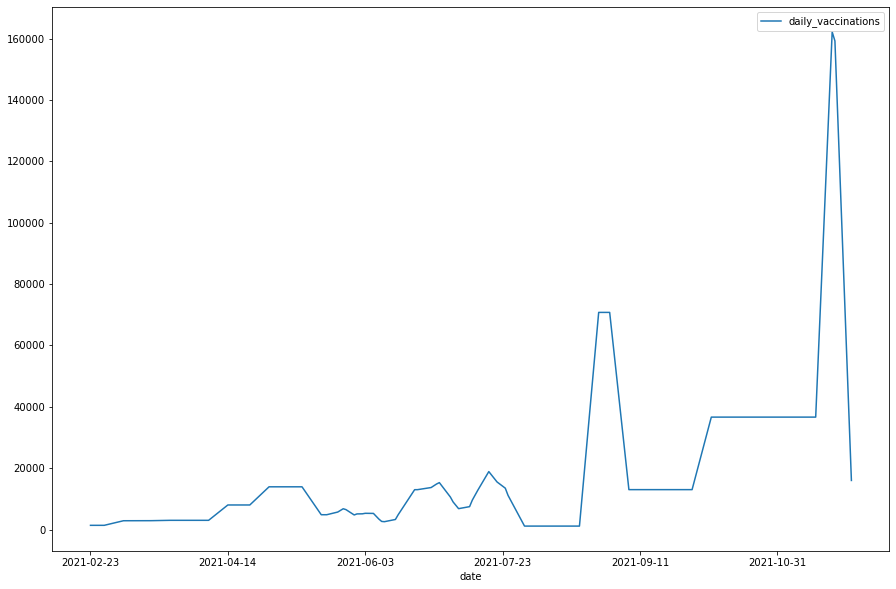

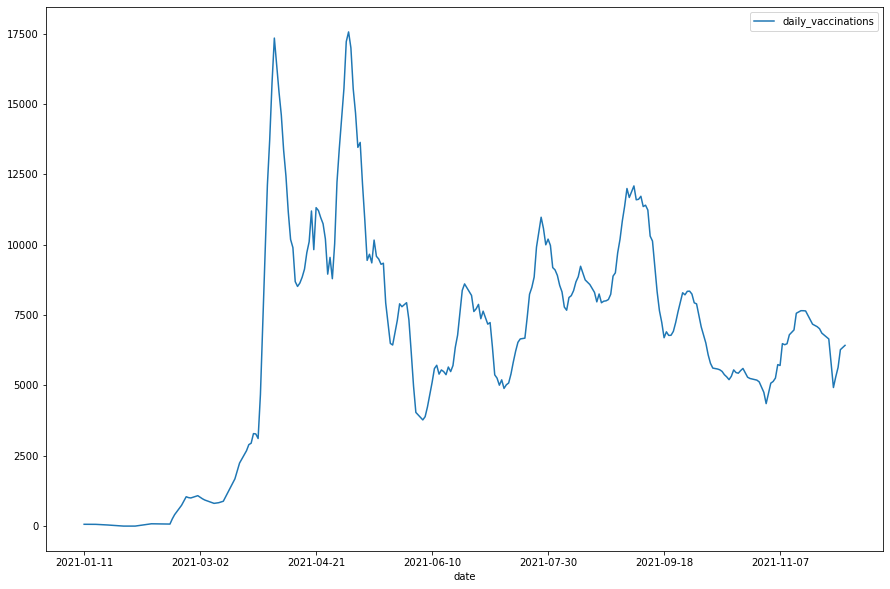

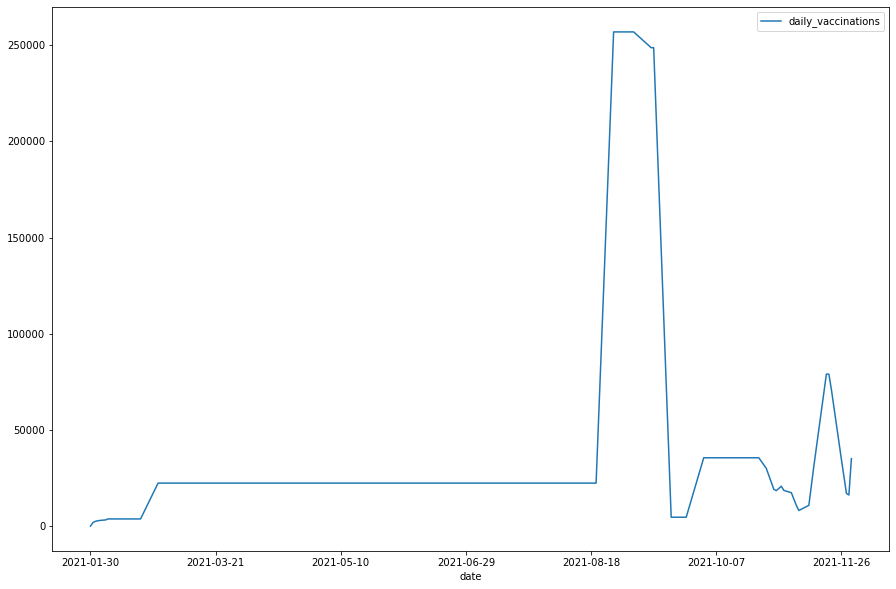

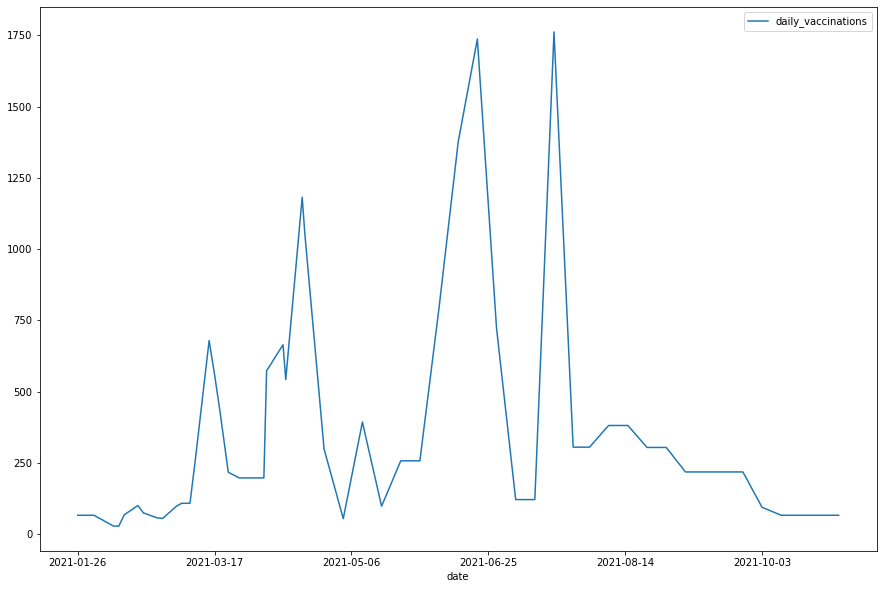

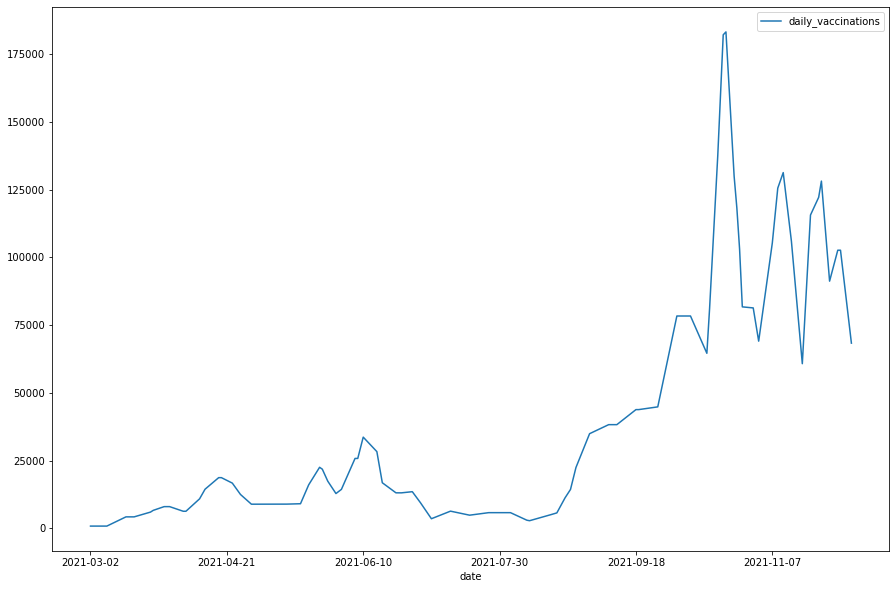

...

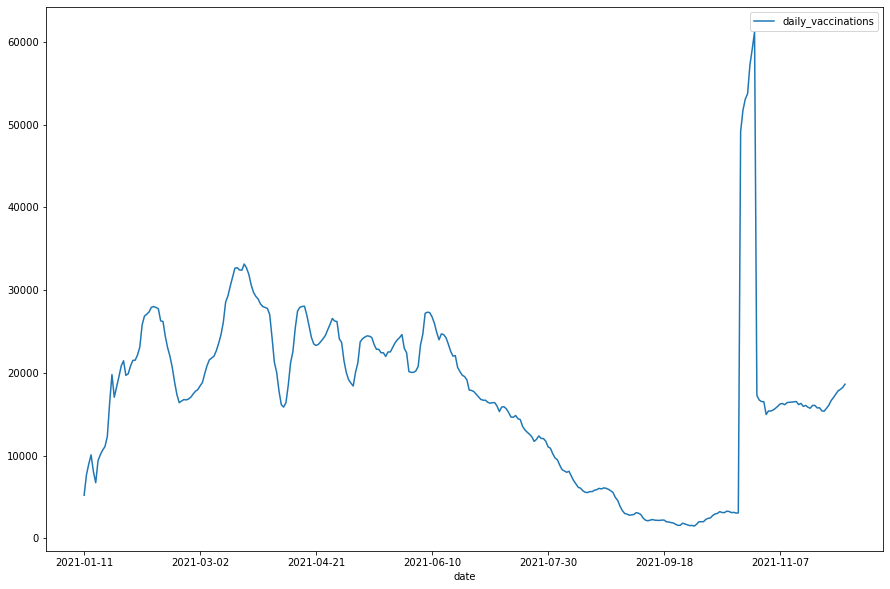

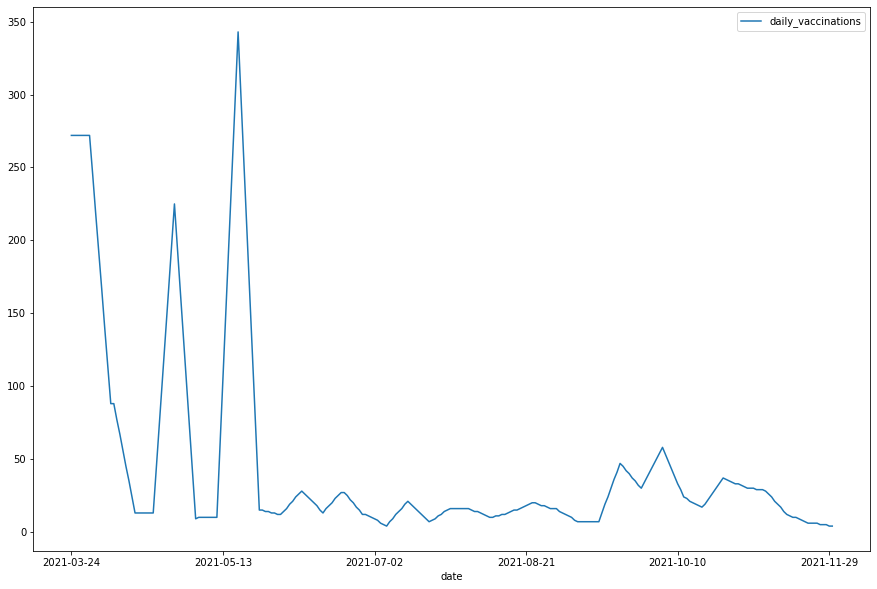

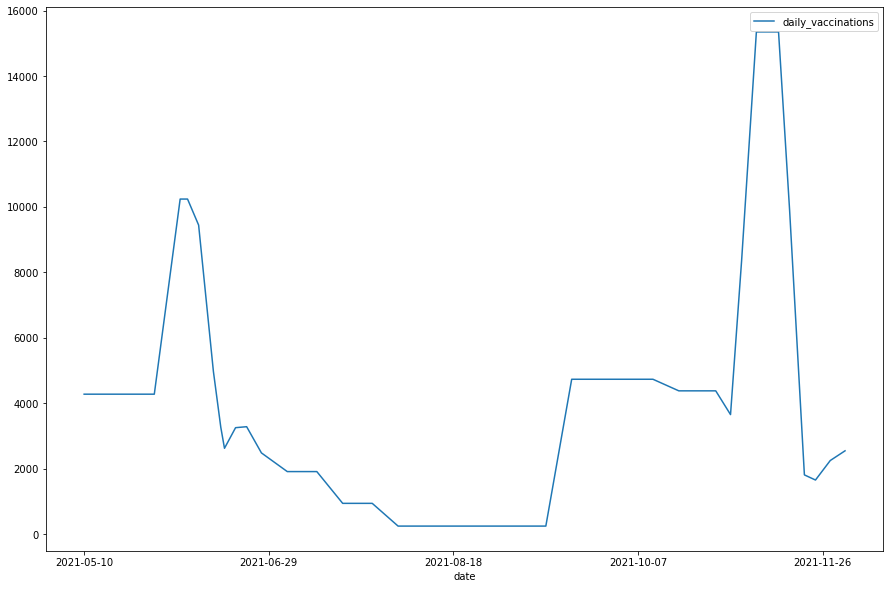

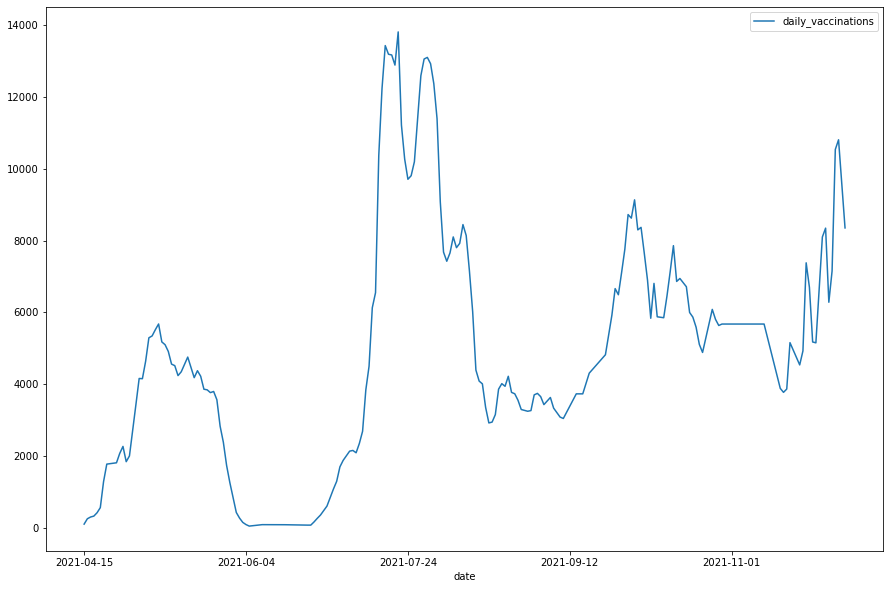

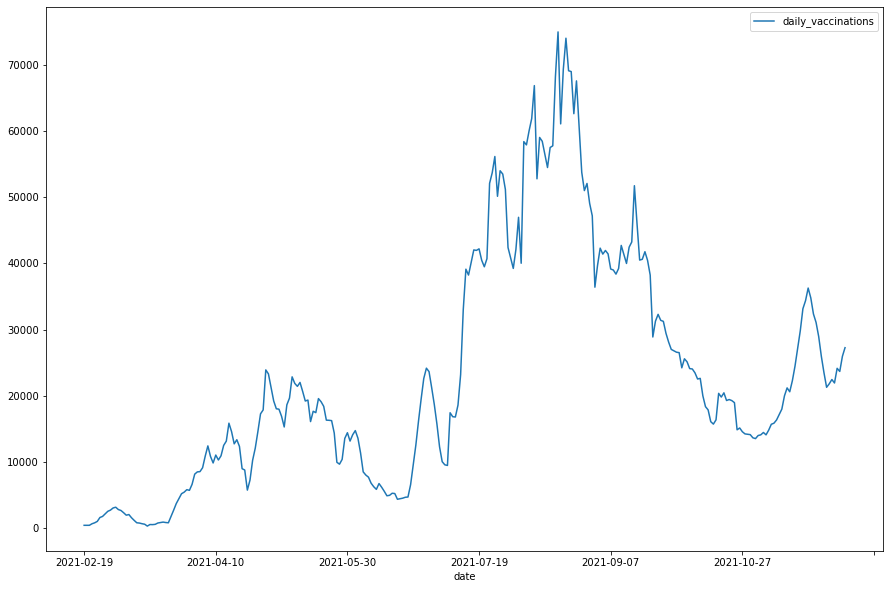

In [18]:
#using pandas to plot line graph for each countries daily vaccinations
for key, df in df_dict.items(): 
    df.plot.line(x='date', y='daily_vaccinations', figsize=(15,10))

In [20]:
#using plotley to plot the daily vaccinations for every country 
for key, df in df_dict.items():
    fig = px.line(df, x="date", y="daily_vaccinations", title='Daily Vaccinations in {0}'.format(key))
    fig.show()